# Afriat

In [1]:
scan=0.13

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: n1qe7poc
Name: peach-moon-135
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/n1qe7poc
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_121714-n1qe7poc/files



GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                 | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                              | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2562,3300,9381
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2562,2586,1684,3419,1647,3345
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4463,10780
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 643,809,2358
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 643,616,424,871,402,854
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1121,2689
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                   | 1/600 [00:13<2:12:38, 13.29s/it]

Epoch 1/600:   0%|▎                                                                                                                                                        | 1/600 [00:13<2:12:38, 13.29s/it, v_num=oc_1, total_loss_train=3.72e+3, kl_local_train=45.9]

Epoch 2/600:   0%|▎                                                                                                                                                        | 1/600 [00:13<2:12:38, 13.29s/it, v_num=oc_1, total_loss_train=3.72e+3, kl_local_train=45.9]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:25<2:05:33, 12.60s/it, v_num=oc_1, total_loss_train=3.72e+3, kl_local_train=45.9]

Epoch 2/600:   0%|▌                                                                                                                                                        | 2/600 [00:25<2:05:33, 12.60s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=60.1]

Epoch 3/600:   0%|▌                                                                                                                                                        | 2/600 [00:25<2:05:33, 12.60s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=60.1]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:37<2:02:54, 12.35s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=60.1]

Epoch 3/600:   0%|▊                                                                                                                                                        | 3/600 [00:37<2:02:54, 12.35s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=58.7]

Epoch 4/600:   0%|▊                                                                                                                                                        | 3/600 [00:37<2:02:54, 12.35s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=58.7]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:49<2:02:01, 12.28s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=58.7]

Epoch 4/600:   1%|█                                                                                                                                                        | 4/600 [00:49<2:02:01, 12.28s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=54.6]

Epoch 5/600:   1%|█                                                                                                                                                        | 4/600 [00:49<2:02:01, 12.28s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=54.6]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:01<2:01:47, 12.28s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=54.6]

Epoch 5/600:   1%|█▎                                                                                                                                                       | 5/600 [01:01<2:01:47, 12.28s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=48.2]

Epoch 6/600:   1%|█▎                                                                                                                                                       | 5/600 [01:03<2:01:47, 12.28s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=48.2]

Epoch 6/600:   1%|█▌                                                                                                                                                       | 6/600 [01:14<2:03:30, 12.47s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=48.2]

Epoch 6/600:   1%|▏                     | 6/600 [01:14<2:03:30, 12.47s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▏                     | 6/600 [01:14<2:03:30, 12.47s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                     | 7/600 [01:26<2:01:01, 12.25s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|▎                      | 7/600 [01:26<2:01:01, 12.25s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=28.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                      | 7/600 [01:26<2:01:01, 12.25s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=28.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                      | 8/600 [01:38<1:59:02, 12.07s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=28.8, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▎                     | 8/600 [01:38<1:59:02, 12.07s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=25.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▎                     | 8/600 [01:38<1:59:02, 12.07s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=25.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▎                     | 9/600 [01:49<1:57:33, 11.93s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=25.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▎                     | 9/600 [01:49<1:57:33, 11.93s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=27.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▎                    | 9/600 [01:49<1:57:33, 11.93s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=27.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▎                   | 10/600 [02:01<1:56:45, 11.87s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=27.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▎                   | 10/600 [02:01<1:56:45, 11.87s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=31.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▎                   | 10/600 [02:02<1:56:45, 11.87s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=31.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▎                   | 11/600 [02:14<1:59:44, 12.20s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=31.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00805, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▎                   | 11/600 [02:14<1:59:44, 12.20s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 12/600:   2%|▎                   | 11/600 [02:14<1:59:44, 12.20s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 12/600:   2%|▍                   | 12/600 [02:26<1:57:49, 12.02s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=35.6, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 12/600:   2%|▍                   | 12/600 [02:26<1:57:49, 12.02s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 13/600:   2%|▍                   | 12/600 [02:26<1:57:49, 12.02s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 13/600:   2%|▍                   | 13/600 [02:37<1:56:32, 11.91s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 13/600:   2%|▍                   | 13/600 [02:37<1:56:32, 11.91s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 14/600:   2%|▍                   | 13/600 [02:37<1:56:32, 11.91s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 14/600:   2%|▍                   | 14/600 [02:49<1:55:29, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 14/600:   2%|▍                   | 14/600 [02:49<1:55:29, 11.83s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 15/600:   2%|▍                   | 14/600 [02:49<1:55:29, 11.83s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 15/600:   2%|▌                   | 15/600 [03:01<1:55:04, 11.80s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 15/600:   2%|▌                   | 15/600 [03:01<1:55:04, 11.80s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=57.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 16/600:   2%|▌                   | 15/600 [03:02<1:55:04, 11.80s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=57.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 16/600:   3%|▌                   | 16/600 [03:14<1:58:07, 12.14s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=57.5, metric_mi|status_control_train=0.0397, metric_mi|zone_train=0.0716, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0601]

Epoch 16/600:   3%|▌                   | 16/600 [03:14<1:58:07, 12.14s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 17/600:   3%|▌                   | 16/600 [03:14<1:58:07, 12.14s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 17/600:   3%|▌                   | 17/600 [03:25<1:56:28, 11.99s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 17/600:   3%|▌                   | 17/600 [03:25<1:56:28, 11.99s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 18/600:   3%|▌                   | 17/600 [03:25<1:56:28, 11.99s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 18/600:   3%|▌                   | 18/600 [03:37<1:55:07, 11.87s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=67.9, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 18/600:   3%|▌                   | 18/600 [03:37<1:55:07, 11.87s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 19/600:   3%|▌                   | 18/600 [03:37<1:55:07, 11.87s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 19/600:   3%|▋                   | 19/600 [03:48<1:54:15, 11.80s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 19/600:   3%|▋                   | 19/600 [03:48<1:54:15, 11.80s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 20/600:   3%|▋                   | 19/600 [03:48<1:54:15, 11.80s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 20/600:   3%|▋                   | 20/600 [04:00<1:53:41, 11.76s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 20/600:   3%|▋                     | 20/600 [04:00<1:53:41, 11.76s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 21/600:   3%|▋                     | 20/600 [04:01<1:53:41, 11.76s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 21/600:   4%|▊                     | 21/600 [04:13<1:56:49, 12.11s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=86, metric_mi|status_control_train=0.0413, metric_mi|zone_train=0.0639, metric_mi|time_cat_train=0.0511, metric_mi|mouse_train=0.0736]

Epoch 21/600:   4%|▋                    | 21/600 [04:13<1:56:49, 12.11s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=91.7, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 22/600:   4%|▋                    | 21/600 [04:13<1:56:49, 12.11s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=91.7, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 22/600:   4%|▊                    | 22/600 [04:25<1:55:20, 11.97s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=91.7, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 22/600:   4%|▊                      | 22/600 [04:25<1:55:20, 11.97s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=95, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 23/600:   4%|▊                      | 22/600 [04:25<1:55:20, 11.97s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=95, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 23/600:   4%|▉                      | 23/600 [04:36<1:54:09, 11.87s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=95, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 23/600:   4%|▊                    | 23/600 [04:36<1:54:09, 11.87s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=99.3, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 24/600:   4%|▊                    | 23/600 [04:36<1:54:09, 11.87s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=99.3, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 24/600:   4%|▊                    | 24/600 [04:48<1:53:19, 11.80s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=99.3, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 24/600:   4%|▉                     | 24/600 [04:48<1:53:19, 11.80s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 25/600:   4%|▉                     | 24/600 [04:48<1:53:19, 11.80s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 25/600:   4%|▉                     | 25/600 [05:00<1:52:51, 11.78s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 25/600:   4%|▉                     | 25/600 [05:00<1:52:51, 11.78s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 26/600:   4%|▉                     | 25/600 [05:01<1:52:51, 11.78s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 26/600:   4%|▉                     | 26/600 [05:13<1:55:53, 12.11s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0667, metric_mi|time_cat_train=0.0925, metric_mi|mouse_train=0.102]

Epoch 26/600:   4%|█                        | 26/600 [05:13<1:55:53, 12.11s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 27/600:   4%|█                        | 26/600 [05:13<1:55:53, 12.11s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 27/600:   4%|█▏                       | 27/600 [05:24<1:54:08, 11.95s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 27/600:   4%|█▏                       | 27/600 [05:24<1:54:08, 11.95s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 28/600:   4%|█▏                       | 27/600 [05:24<1:54:08, 11.95s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 28/600:   5%|█▏                       | 28/600 [05:36<1:52:48, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 28/600:   5%|█▏                       | 28/600 [05:36<1:52:48, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 29/600:   5%|█▏                       | 28/600 [05:36<1:52:48, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 29/600:   5%|█▏                       | 29/600 [05:47<1:51:44, 11.74s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 29/600:   5%|█▏                       | 29/600 [05:47<1:51:44, 11.74s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 30/600:   5%|█▏                       | 29/600 [05:47<1:51:44, 11.74s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 30/600:   5%|█▎                       | 30/600 [05:59<1:51:13, 11.71s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 30/600:   5%|█▎                       | 30/600 [05:59<1:51:13, 11.71s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 31/600:   5%|█▎                       | 30/600 [06:00<1:51:13, 11.71s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 31/600:   5%|█▎                       | 31/600 [06:12<1:54:41, 12.09s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.113]

Epoch 31/600:   5%|█▎                        | 31/600 [06:12<1:54:41, 12.09s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▎                        | 31/600 [06:12<1:54:41, 12.09s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▍                        | 32/600 [06:24<1:53:18, 11.97s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 32/600:   5%|█▍                        | 32/600 [06:24<1:53:18, 11.97s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 33/600:   5%|█▍                        | 32/600 [06:24<1:53:18, 11.97s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|█▍                        | 33/600 [06:35<1:52:15, 11.88s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 33/600:   6%|█▍                        | 33/600 [06:35<1:52:15, 11.88s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                        | 33/600 [06:35<1:52:15, 11.88s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                        | 34/600 [06:47<1:51:32, 11.83s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 34/600:   6%|█▍                        | 34/600 [06:47<1:51:32, 11.83s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▍                        | 34/600 [06:47<1:51:32, 11.83s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▌                        | 35/600 [06:59<1:51:02, 11.79s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 35/600:   6%|█▌                        | 35/600 [06:59<1:51:02, 11.79s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                        | 35/600 [07:00<1:51:02, 11.79s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                        | 36/600 [07:12<1:54:02, 12.13s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.117]

Epoch 36/600:   6%|█▌                        | 36/600 [07:12<1:54:02, 12.13s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 36/600 [07:12<1:54:02, 12.13s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 37/600 [07:23<1:52:36, 12.00s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 37/600:   6%|█▌                        | 37/600 [07:23<1:52:36, 12.00s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▌                        | 37/600 [07:23<1:52:36, 12.00s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                        | 38/600 [07:35<1:51:33, 11.91s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 38/600:   6%|█▋                        | 38/600 [07:35<1:51:33, 11.91s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                        | 38/600 [07:35<1:51:33, 11.91s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                        | 39/600 [07:47<1:50:47, 11.85s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 39/600:   6%|█▋                        | 39/600 [07:47<1:50:47, 11.85s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 40/600:   6%|█▋                        | 39/600 [07:47<1:50:47, 11.85s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 40/600:   7%|█▋                        | 40/600 [07:58<1:50:12, 11.81s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 40/600:   7%|█▊                         | 40/600 [07:58<1:50:12, 11.81s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                         | 40/600 [08:00<1:50:12, 11.81s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                         | 41/600 [08:11<1:53:15, 12.16s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 41/600:   7%|█▊                        | 41/600 [08:11<1:53:15, 12.16s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 41/600 [08:11<1:53:15, 12.16s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 42/600 [08:23<1:51:48, 12.02s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 42/600:   7%|█▊                        | 42/600 [08:23<1:51:48, 12.02s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 42/600 [08:23<1:51:48, 12.02s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 43/600 [08:35<1:50:41, 11.92s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 43/600:   7%|█▊                        | 43/600 [08:35<1:50:41, 11.92s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▊                        | 43/600 [08:35<1:50:41, 11.92s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▉                        | 44/600 [08:46<1:49:51, 11.86s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 44/600:   7%|█▉                        | 44/600 [08:46<1:49:51, 11.86s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 45/600:   7%|█▉                        | 44/600 [08:46<1:49:51, 11.86s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|█▉                        | 45/600 [08:59<1:50:17, 11.92s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 45/600:   8%|█▉                       | 45/600 [08:59<1:50:17, 11.92s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                       | 45/600 [09:00<1:50:17, 11.92s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                       | 46/600 [09:12<1:53:03, 12.24s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.124]

Epoch 46/600:   8%|█▉                        | 46/600 [09:12<1:53:03, 12.24s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|█▉                        | 46/600 [09:12<1:53:03, 12.24s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                        | 47/600 [09:23<1:51:27, 12.09s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 47/600:   8%|██                        | 47/600 [09:23<1:51:27, 12.09s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                        | 47/600 [09:23<1:51:27, 12.09s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                        | 48/600 [09:35<1:50:13, 11.98s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 48/600:   8%|██                        | 48/600 [09:35<1:50:13, 11.98s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                        | 48/600 [09:35<1:50:13, 11.98s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                        | 49/600 [09:47<1:49:47, 11.96s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 49/600:   8%|██                        | 49/600 [09:47<1:49:47, 11.96s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██                        | 49/600 [09:47<1:49:47, 11.96s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▏                       | 50/600 [09:59<1:49:03, 11.90s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 50/600:   8%|██▏                       | 50/600 [09:59<1:49:03, 11.90s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                       | 50/600 [10:00<1:49:03, 11.90s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                       | 51/600 [10:12<1:51:47, 12.22s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 51/600:   8%|██▏                      | 51/600 [10:12<1:51:47, 12.22s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 52/600:   8%|██▏                      | 51/600 [10:12<1:51:47, 12.22s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|██▏                      | 52/600 [10:23<1:50:06, 12.05s/it, v_num=oc_1, total_loss_train=3.22e+3, kl_local_train=109, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|██▏                      | 52/600 [10:23<1:50:06, 12.05s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|██▏                      | 52/600 [10:23<1:50:06, 12.05s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|██▏                      | 53/600 [10:35<1:48:57, 11.95s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|██▏                      | 53/600 [10:35<1:48:57, 11.95s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|██▏                      | 53/600 [10:35<1:48:57, 11.95s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|██▎                      | 54/600 [10:47<1:48:07, 11.88s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|██▎                      | 54/600 [10:47<1:48:07, 11.88s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|██▎                      | 54/600 [10:47<1:48:07, 11.88s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|██▎                      | 55/600 [10:58<1:47:22, 11.82s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|██▎                      | 55/600 [10:58<1:47:22, 11.82s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|██▎                      | 55/600 [11:00<1:47:22, 11.82s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|██▎                      | 56/600 [11:11<1:50:20, 12.17s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|██▎                      | 56/600 [11:11<1:50:20, 12.17s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 57/600:   9%|██▎                      | 56/600 [11:11<1:50:20, 12.17s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|██▍                      | 57/600 [11:23<1:48:49, 12.02s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|██▍                      | 57/600 [11:23<1:48:49, 12.02s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|██▍                      | 57/600 [11:23<1:48:49, 12.02s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|██▍                      | 58/600 [11:35<1:47:45, 11.93s/it, v_num=oc_1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|██▌                       | 58/600 [11:35<1:47:45, 11.93s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|██▌                       | 58/600 [11:35<1:47:45, 11.93s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|██▌                       | 59/600 [11:47<1:46:59, 11.87s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|██▌                       | 59/600 [11:47<1:46:59, 11.87s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|██▌                       | 59/600 [11:47<1:46:59, 11.87s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|██▌                       | 60/600 [11:58<1:46:17, 11.81s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|██▌                      | 60/600 [11:58<1:46:17, 11.81s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|██▌                      | 60/600 [11:59<1:46:17, 11.81s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|██▌                      | 61/600 [12:11<1:49:17, 12.17s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=99.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|██▌                      | 61/600 [12:11<1:49:17, 12.17s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▌                      | 61/600 [12:11<1:49:17, 12.17s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▌                      | 62/600 [12:23<1:47:55, 12.04s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 62/600:  10%|██▌                      | 62/600 [12:23<1:47:55, 12.04s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▌                      | 62/600 [12:23<1:47:55, 12.04s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                      | 63/600 [12:35<1:46:47, 11.93s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 63/600:  10%|██▋                      | 63/600 [12:35<1:46:47, 11.93s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=97.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 64/600:  10%|██▋                      | 63/600 [12:35<1:46:47, 11.93s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=97.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▋                      | 64/600 [12:46<1:46:02, 11.87s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=97.8, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 64/600:  11%|██▋                      | 64/600 [12:46<1:46:02, 11.87s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▋                      | 64/600 [12:46<1:46:02, 11.87s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▋                      | 65/600 [12:58<1:45:23, 11.82s/it, v_num=oc_1, total_loss_train=3.2e+3, kl_local_train=96.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 65/600:  11%|██▌                     | 65/600 [12:58<1:45:23, 11.82s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=95.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▌                     | 65/600 [12:59<1:45:23, 11.82s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=95.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▋                     | 66/600 [13:11<1:48:27, 12.19s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=95.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 66/600:  11%|██▋                     | 66/600 [13:11<1:48:27, 12.19s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=94.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 67/600:  11%|██▋                     | 66/600 [13:11<1:48:27, 12.19s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=94.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 67/600:  11%|██▋                     | 67/600 [13:23<1:47:09, 12.06s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=94.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 67/600:  11%|██▋                     | 67/600 [13:23<1:47:09, 12.06s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=93.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 68/600:  11%|██▋                     | 67/600 [13:23<1:47:09, 12.06s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=93.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 68/600:  11%|██▋                     | 68/600 [13:35<1:46:02, 11.96s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=93.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 68/600:  11%|██▋                     | 68/600 [13:35<1:46:02, 11.96s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=92.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 69/600:  11%|██▋                     | 68/600 [13:35<1:46:02, 11.96s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=92.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 69/600:  12%|██▊                     | 69/600 [13:46<1:45:16, 11.90s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=92.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 69/600:  12%|██▊                     | 69/600 [13:46<1:45:16, 11.90s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=92.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 70/600:  12%|██▊                     | 69/600 [13:46<1:45:16, 11.90s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=92.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 70/600:  12%|██▊                     | 70/600 [13:58<1:44:36, 11.84s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=92.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 70/600:  12%|██▊                     | 70/600 [13:58<1:44:36, 11.84s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 71/600:  12%|██▊                     | 70/600 [13:59<1:44:36, 11.84s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 71/600:  12%|██▊                     | 71/600 [14:11<1:47:33, 12.20s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=91.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 71/600:  12%|██▊                     | 71/600 [14:11<1:47:33, 12.20s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=91.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|██▊                     | 71/600 [14:11<1:47:33, 12.20s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=91.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|██▉                     | 72/600 [14:23<1:46:14, 12.07s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=91.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|██▉                     | 72/600 [14:23<1:46:14, 12.07s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=90.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|██▉                     | 72/600 [14:23<1:46:14, 12.07s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=90.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|██▉                     | 73/600 [14:35<1:45:09, 11.97s/it, v_num=oc_1, total_loss_train=3.19e+3, kl_local_train=90.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|██▉                     | 73/600 [14:35<1:45:09, 11.97s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|██▉                     | 73/600 [14:35<1:45:09, 11.97s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|██▉                     | 74/600 [14:46<1:44:42, 11.94s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=89.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|██▉                     | 74/600 [14:46<1:44:42, 11.94s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=88.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|██▉                     | 74/600 [14:46<1:44:42, 11.94s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=88.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|███                     | 75/600 [14:58<1:44:15, 11.91s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=88.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|███                     | 75/600 [14:58<1:44:15, 11.91s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 76/600:  12%|███                     | 75/600 [15:00<1:44:15, 11.91s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|███                     | 76/600 [15:11<1:46:54, 12.24s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|███▏                     | 76/600 [15:11<1:46:54, 12.24s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 77/600:  13%|███▏                     | 76/600 [15:11<1:46:54, 12.24s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 77/600:  13%|███▏                     | 77/600 [15:23<1:45:17, 12.08s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 77/600:  13%|███▏                     | 77/600 [15:23<1:45:17, 12.08s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 78/600:  13%|███▏                     | 77/600 [15:23<1:45:17, 12.08s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 78/600:  13%|███▎                     | 78/600 [15:35<1:43:57, 11.95s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 78/600:  13%|███▎                     | 78/600 [15:35<1:43:57, 11.95s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 79/600:  13%|███▎                     | 78/600 [15:35<1:43:57, 11.95s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 79/600:  13%|███▎                     | 79/600 [15:46<1:43:04, 11.87s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 79/600:  13%|███▎                     | 79/600 [15:46<1:43:04, 11.87s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 80/600:  13%|███▎                     | 79/600 [15:46<1:43:04, 11.87s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 80/600:  13%|███▎                     | 80/600 [15:58<1:42:25, 11.82s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 80/600:  13%|███▎                     | 80/600 [15:58<1:42:25, 11.82s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 81/600:  13%|███▎                     | 80/600 [15:59<1:42:25, 11.82s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 81/600:  14%|███▍                     | 81/600 [16:11<1:45:01, 12.14s/it, v_num=oc_1, total_loss_train=3.18e+3, kl_local_train=85.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 81/600:  14%|███▋                       | 81/600 [16:11<1:45:01, 12.14s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=85, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|███▋                       | 81/600 [16:11<1:45:01, 12.14s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=85, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|███▋                       | 82/600 [16:23<1:43:33, 12.00s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=85, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 82/600:  14%|███▍                     | 82/600 [16:23<1:43:33, 12.00s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|███▍                     | 82/600 [16:23<1:43:33, 12.00s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|███▍                     | 83/600 [16:34<1:42:25, 11.89s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 83/600:  14%|███▋                       | 83/600 [16:34<1:42:25, 11.89s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|███▋                       | 83/600 [16:34<1:42:25, 11.89s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|███▊                       | 84/600 [16:46<1:41:33, 11.81s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=83, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 84/600:  14%|███▌                     | 84/600 [16:46<1:41:33, 11.81s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|███▌                     | 84/600 [16:46<1:41:33, 11.81s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|███▌                     | 85/600 [16:57<1:40:45, 11.74s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 85/600:  14%|███▌                     | 85/600 [16:57<1:40:45, 11.74s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|███▌                     | 85/600 [16:59<1:40:45, 11.74s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|███▌                     | 86/600 [17:10<1:43:26, 12.07s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 86/600:  14%|███▋                      | 86/600 [17:10<1:43:26, 12.07s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|███▋                      | 86/600 [17:10<1:43:26, 12.07s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|███▊                      | 87/600 [17:22<1:42:02, 11.93s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 87/600:  14%|███▍                    | 87/600 [17:22<1:42:02, 11.93s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=81.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 88/600:  14%|███▍                    | 87/600 [17:22<1:42:02, 11.93s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=81.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|███▌                    | 88/600 [17:33<1:40:56, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=81.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 88/600:  15%|███▌                    | 88/600 [17:33<1:40:56, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|███▌                    | 88/600 [17:33<1:40:56, 11.83s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|███▌                    | 89/600 [17:45<1:40:08, 11.76s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 89/600:  15%|███▌                    | 89/600 [17:45<1:40:08, 11.76s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|███▌                    | 89/600 [17:45<1:40:08, 11.76s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|███▌                    | 90/600 [17:57<1:39:32, 11.71s/it, v_num=oc_1, total_loss_train=3.17e+3, kl_local_train=80.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 90/600:  15%|███▌                    | 90/600 [17:57<1:39:32, 11.71s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|███▌                    | 90/600 [17:58<1:39:32, 11.71s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|███▋                    | 91/600 [18:10<1:42:16, 12.06s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 91/600:  15%|███▋                    | 91/600 [18:10<1:42:16, 12.06s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 92/600:  15%|███▋                    | 91/600 [18:10<1:42:16, 12.06s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 92/600:  15%|███▋                    | 92/600 [18:21<1:40:53, 11.92s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=79.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 92/600:  15%|███▋                    | 92/600 [18:21<1:40:53, 11.92s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 93/600:  15%|███▋                    | 92/600 [18:21<1:40:53, 11.92s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 93/600:  16%|███▋                    | 93/600 [18:33<1:39:52, 11.82s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=79.5, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 93/600:  16%|███▋                    | 93/600 [18:33<1:39:52, 11.82s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 94/600:  16%|███▋                    | 93/600 [18:33<1:39:52, 11.82s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 94/600:  16%|███▊                    | 94/600 [18:44<1:39:07, 11.75s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=78.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 94/600:  16%|███▊                    | 94/600 [18:44<1:39:07, 11.75s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 95/600:  16%|███▊                    | 94/600 [18:44<1:39:07, 11.75s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 95/600:  16%|███▊                    | 95/600 [18:56<1:38:37, 11.72s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 95/600:  16%|███▊                    | 95/600 [18:56<1:38:37, 11.72s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 96/600:  16%|███▊                    | 95/600 [18:57<1:38:37, 11.72s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 96/600:  16%|███▊                    | 96/600 [19:09<1:41:17, 12.06s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 96/600:  16%|███▊                    | 96/600 [19:09<1:41:17, 12.06s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 97/600:  16%|███▊                    | 96/600 [19:09<1:41:17, 12.06s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 97/600:  16%|███▉                    | 97/600 [19:20<1:39:54, 11.92s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 97/600:  16%|███▉                    | 97/600 [19:20<1:39:54, 11.92s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=76.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 98/600:  16%|███▉                    | 97/600 [19:20<1:39:54, 11.92s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=76.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 98/600:  16%|███▉                    | 98/600 [19:32<1:38:57, 11.83s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=76.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 98/600:  16%|███▉                    | 98/600 [19:32<1:38:57, 11.83s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=76.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 99/600:  16%|███▉                    | 98/600 [19:32<1:38:57, 11.83s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=76.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 99/600:  16%|███▉                    | 99/600 [19:44<1:38:13, 11.76s/it, v_num=oc_1, total_loss_train=3.16e+3, kl_local_train=76.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 99/600:  16%|████▎                     | 99/600 [19:44<1:38:13, 11.76s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 100/600:  16%|████▏                    | 99/600 [19:44<1:38:13, 11.76s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 100/600:  17%|████                    | 100/600 [19:55<1:37:52, 11.75s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=76, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 100/600:  17%|███▋                  | 100/600 [19:55<1:37:52, 11.75s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 101/600:  17%|███▋                  | 100/600 [19:57<1:37:52, 11.75s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 101/600:  17%|███▋                  | 101/600 [20:08<1:40:29, 12.08s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 101/600:  17%|███▋                  | 101/600 [20:08<1:40:29, 12.08s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 102/600:  17%|███▋                  | 101/600 [20:08<1:40:29, 12.08s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 102/600:  17%|███▋                  | 102/600 [20:20<1:39:10, 11.95s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 102/600:  17%|███▋                  | 102/600 [20:20<1:39:10, 11.95s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 103/600:  17%|███▋                  | 102/600 [20:20<1:39:10, 11.95s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 103/600:  17%|███▊                  | 103/600 [20:31<1:38:06, 11.84s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 103/600:  17%|███▊                  | 103/600 [20:31<1:38:06, 11.84s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 104/600:  17%|███▊                  | 103/600 [20:31<1:38:06, 11.84s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 104/600:  17%|███▊                  | 104/600 [20:43<1:37:13, 11.76s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 104/600:  17%|████▏                   | 104/600 [20:43<1:37:13, 11.76s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=74, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 105/600:  17%|████▏                   | 104/600 [20:43<1:37:13, 11.76s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=74, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 105/600:  18%|████▏                   | 105/600 [20:55<1:36:38, 11.71s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=74, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 105/600:  18%|███▊                  | 105/600 [20:55<1:36:38, 11.71s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 106/600:  18%|███▊                  | 105/600 [20:56<1:36:38, 11.71s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 106/600:  18%|███▉                  | 106/600 [21:07<1:39:12, 12.05s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 106/600:  18%|████                   | 106/600 [21:07<1:39:12, 12.05s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 107/600:  18%|████                   | 106/600 [21:07<1:39:12, 12.05s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 107/600:  18%|████                   | 107/600 [21:19<1:37:51, 11.91s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 107/600:  18%|████                   | 107/600 [21:19<1:37:51, 11.91s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 108/600:  18%|████                   | 107/600 [21:19<1:37:51, 11.91s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 108/600:  18%|████▏                  | 108/600 [21:31<1:36:57, 11.82s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=72.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 108/600:  18%|████▏                  | 108/600 [21:31<1:36:57, 11.82s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 109/600:  18%|████▏                  | 108/600 [21:31<1:36:57, 11.82s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 109/600:  18%|████▏                  | 109/600 [21:42<1:36:06, 11.74s/it, v_num=oc_1, total_loss_train=3.15e+3, kl_local_train=72.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 109/600:  18%|████▏                  | 109/600 [21:42<1:36:06, 11.74s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 110/600:  18%|████▏                  | 109/600 [21:42<1:36:06, 11.74s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 110/600:  18%|████▏                  | 110/600 [21:54<1:35:35, 11.71s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 110/600:  18%|████▏                  | 110/600 [21:54<1:35:35, 11.71s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 111/600:  18%|████▏                  | 110/600 [21:55<1:35:35, 11.71s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 111/600:  18%|████▎                  | 111/600 [22:07<1:38:13, 12.05s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 111/600:  18%|████                  | 111/600 [22:07<1:38:13, 12.05s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 112/600:  18%|████                  | 111/600 [22:07<1:38:13, 12.05s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 112/600:  19%|████                  | 112/600 [22:18<1:36:50, 11.91s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 112/600:  19%|████                  | 112/600 [22:18<1:36:50, 11.91s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 113/600:  19%|████                  | 112/600 [22:18<1:36:50, 11.91s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 113/600:  19%|████▏                 | 113/600 [22:30<1:35:52, 11.81s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=71.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 113/600:  19%|████▏                 | 113/600 [22:30<1:35:52, 11.81s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 114/600:  19%|████▏                 | 113/600 [22:30<1:35:52, 11.81s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 114/600:  19%|████▏                 | 114/600 [22:41<1:35:02, 11.73s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 114/600:  19%|████▏                 | 114/600 [22:41<1:35:02, 11.73s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 115/600:  19%|████▏                 | 114/600 [22:41<1:35:02, 11.73s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 115/600:  19%|████▏                 | 115/600 [22:53<1:34:35, 11.70s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 115/600:  19%|████▏                 | 115/600 [22:53<1:34:35, 11.70s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 116/600:  19%|████▏                 | 115/600 [22:54<1:34:35, 11.70s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 116/600:  19%|████▎                 | 116/600 [23:06<1:37:06, 12.04s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 116/600:  19%|████▋                   | 116/600 [23:06<1:37:06, 12.04s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 117/600:  19%|████▋                   | 116/600 [23:06<1:37:06, 12.04s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 117/600:  20%|████▋                   | 117/600 [23:17<1:35:48, 11.90s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 117/600:  20%|████▋                   | 117/600 [23:17<1:35:48, 11.90s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 118/600:  20%|████▋                   | 117/600 [23:17<1:35:48, 11.90s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 118/600:  20%|████▋                   | 118/600 [23:29<1:34:50, 11.81s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 118/600:  20%|████▋                   | 118/600 [23:29<1:34:50, 11.81s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 119/600:  20%|████▋                   | 118/600 [23:29<1:34:50, 11.81s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 119/600:  20%|████▊                   | 119/600 [23:41<1:33:59, 11.72s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 119/600:  20%|████▊                   | 119/600 [23:41<1:33:59, 11.72s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 120/600:  20%|████▊                   | 119/600 [23:41<1:33:59, 11.72s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 120/600:  20%|████▊                   | 120/600 [23:52<1:33:41, 11.71s/it, v_num=oc_1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 120/600:  20%|████▊                   | 120/600 [23:52<1:33:41, 11.71s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 121/600:  20%|████▊                   | 120/600 [23:53<1:33:41, 11.71s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 121/600:  20%|████▊                   | 121/600 [24:05<1:36:09, 12.04s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 121/600:  20%|████▍                 | 121/600 [24:05<1:36:09, 12.04s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▍                 | 121/600 [24:05<1:36:09, 12.04s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▍                 | 122/600 [24:17<1:34:52, 11.91s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|████▍                 | 122/600 [24:17<1:34:52, 11.91s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▍                 | 122/600 [24:17<1:34:52, 11.91s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▌                 | 123/600 [24:28<1:33:53, 11.81s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|████▌                 | 123/600 [24:28<1:33:53, 11.81s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 124/600:  20%|████▌                 | 123/600 [24:28<1:33:53, 11.81s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|████▌                 | 124/600 [24:40<1:33:04, 11.73s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|████▌                 | 124/600 [24:40<1:33:04, 11.73s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▌                 | 124/600 [24:40<1:33:04, 11.73s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▌                 | 125/600 [24:51<1:32:46, 11.72s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|████▌                 | 125/600 [24:51<1:32:46, 11.72s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▌                 | 125/600 [24:53<1:32:46, 11.72s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▌                 | 126/600 [25:04<1:35:12, 12.05s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|████▌                 | 126/600 [25:04<1:35:12, 12.05s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 127/600:  21%|████▌                 | 126/600 [25:04<1:35:12, 12.05s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 127/600:  21%|████▋                 | 127/600 [25:16<1:33:53, 11.91s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 127/600:  21%|████▋                 | 127/600 [25:16<1:33:53, 11.91s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 128/600:  21%|████▋                 | 127/600 [25:16<1:33:53, 11.91s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 128/600:  21%|████▋                 | 128/600 [25:27<1:32:51, 11.80s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 128/600:  21%|████▋                 | 128/600 [25:27<1:32:51, 11.80s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 129/600:  21%|████▋                 | 128/600 [25:27<1:32:51, 11.80s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 129/600:  22%|████▋                 | 129/600 [25:39<1:32:01, 11.72s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 129/600:  22%|████▋                 | 129/600 [25:39<1:32:01, 11.72s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 130/600:  22%|████▋                 | 129/600 [25:39<1:32:01, 11.72s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 130/600:  22%|████▊                 | 130/600 [25:50<1:31:25, 11.67s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 130/600:  22%|████▊                 | 130/600 [25:50<1:31:25, 11.67s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 131/600:  22%|████▊                 | 130/600 [25:52<1:31:25, 11.67s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 131/600:  22%|████▊                 | 131/600 [26:03<1:33:53, 12.01s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.112]

Epoch 131/600:  22%|█████                  | 131/600 [26:03<1:33:53, 12.01s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 132/600:  22%|█████                  | 131/600 [26:03<1:33:53, 12.01s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 132/600:  22%|█████                  | 132/600 [26:15<1:32:39, 11.88s/it, v_num=oc_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 132/600:  22%|█████                  | 132/600 [26:15<1:32:39, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 133/600:  22%|█████                  | 132/600 [26:15<1:32:39, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 133/600:  22%|█████                  | 133/600 [26:26<1:31:38, 11.77s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=66.2, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 133/600:  22%|█████                  | 133/600 [26:26<1:31:38, 11.77s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 134/600:  22%|█████                  | 133/600 [26:26<1:31:38, 11.77s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 134/600:  22%|█████▏                 | 134/600 [26:38<1:30:59, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 134/600:  22%|█████▏                 | 134/600 [26:38<1:30:59, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 135/600:  22%|█████▏                 | 134/600 [26:38<1:30:59, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 135/600:  22%|█████▏                 | 135/600 [26:50<1:30:26, 11.67s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 135/600:  22%|█████▏                 | 135/600 [26:50<1:30:26, 11.67s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 136/600:  22%|█████▏                 | 135/600 [26:51<1:30:26, 11.67s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 136/600:  23%|█████▏                 | 136/600 [27:02<1:32:51, 12.01s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 136/600:  23%|█████▏                 | 136/600 [27:02<1:32:51, 12.01s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 137/600:  23%|█████▏                 | 136/600 [27:02<1:32:51, 12.01s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 137/600:  23%|█████▎                 | 137/600 [27:14<1:31:39, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 137/600:  23%|█████▎                 | 137/600 [27:14<1:31:39, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 138/600:  23%|█████▎                 | 137/600 [27:14<1:31:39, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 138/600:  23%|█████▎                 | 138/600 [27:25<1:30:40, 11.78s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 138/600:  23%|█████▎                 | 138/600 [27:25<1:30:40, 11.78s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 139/600:  23%|█████▎                 | 138/600 [27:25<1:30:40, 11.78s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 139/600:  23%|█████▎                 | 139/600 [27:37<1:30:02, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 139/600:  23%|█████▎                 | 139/600 [27:37<1:30:02, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 140/600:  23%|█████▎                 | 139/600 [27:37<1:30:02, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 140/600:  23%|█████▎                 | 140/600 [27:49<1:29:28, 11.67s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 140/600:  23%|█████▊                   | 140/600 [27:49<1:29:28, 11.67s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 141/600:  23%|█████▊                   | 140/600 [27:50<1:29:28, 11.67s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 141/600:  24%|█████▉                   | 141/600 [28:01<1:31:53, 12.01s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 141/600:  24%|█████▋                  | 141/600 [28:01<1:31:53, 12.01s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 142/600:  24%|█████▋                  | 141/600 [28:01<1:31:53, 12.01s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 142/600:  24%|█████▋                  | 142/600 [28:13<1:30:42, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 142/600:  24%|█████▋                  | 142/600 [28:13<1:30:42, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 143/600:  24%|█████▋                  | 142/600 [28:13<1:30:42, 11.88s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 143/600:  24%|█████▋                  | 143/600 [28:25<1:29:45, 11.79s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 143/600:  24%|█████▏                | 143/600 [28:25<1:29:45, 11.79s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 144/600:  24%|█████▏                | 143/600 [28:25<1:29:45, 11.79s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 144/600:  24%|█████▎                | 144/600 [28:36<1:29:06, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 144/600:  24%|█████▎                | 144/600 [28:36<1:29:06, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 145/600:  24%|█████▎                | 144/600 [28:36<1:29:06, 11.72s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 145/600:  24%|█████▎                | 145/600 [28:48<1:28:33, 11.68s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 145/600:  24%|█████▎                | 145/600 [28:48<1:28:33, 11.68s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 146/600:  24%|█████▎                | 145/600 [28:49<1:28:33, 11.68s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 146/600:  24%|█████▎                | 146/600 [29:01<1:31:01, 12.03s/it, v_num=oc_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.107]

Epoch 146/600:  24%|█████▎                | 146/600 [29:01<1:31:01, 12.03s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 147/600:  24%|█████▎                | 146/600 [29:01<1:31:01, 12.03s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 147/600:  24%|█████▍                | 147/600 [29:12<1:29:50, 11.90s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 147/600:  24%|█████▍                | 147/600 [29:12<1:29:50, 11.90s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 148/600:  24%|█████▍                | 147/600 [29:12<1:29:50, 11.90s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 148/600:  25%|█████▍                | 148/600 [29:24<1:28:53, 11.80s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 148/600:  25%|█████▍                | 148/600 [29:24<1:28:53, 11.80s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 149/600:  25%|█████▍                | 148/600 [29:24<1:28:53, 11.80s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 149/600:  25%|█████▍                | 149/600 [29:35<1:28:13, 11.74s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 149/600:  25%|█████▍                | 149/600 [29:35<1:28:13, 11.74s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 150/600:  25%|█████▍                | 149/600 [29:35<1:28:13, 11.74s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 150/600:  25%|█████▌                | 150/600 [29:47<1:28:08, 11.75s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 150/600:  25%|█████▌                | 150/600 [29:47<1:28:08, 11.75s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 151/600:  25%|█████▌                | 150/600 [29:48<1:28:08, 11.75s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 151/600:  25%|█████▌                | 151/600 [30:00<1:30:38, 12.11s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.106]

Epoch 151/600:  25%|█████▌                | 151/600 [30:00<1:30:38, 12.11s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|█████▌                | 151/600 [30:00<1:30:38, 12.11s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|█████▌                | 152/600 [30:12<1:29:21, 11.97s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|█████▌                | 152/600 [30:12<1:29:21, 11.97s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  25%|█████▌                | 152/600 [30:12<1:29:21, 11.97s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|█████▌                | 153/600 [30:23<1:28:18, 11.85s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=62.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|█████▌                | 153/600 [30:23<1:28:18, 11.85s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|█████▌                | 153/600 [30:23<1:28:18, 11.85s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|█████▋                | 154/600 [30:35<1:27:33, 11.78s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|█████▋                | 154/600 [30:35<1:27:33, 11.78s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|█████▋                | 154/600 [30:35<1:27:33, 11.78s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|█████▋                | 155/600 [30:46<1:26:57, 11.72s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|█████▋                | 155/600 [30:46<1:26:57, 11.72s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|█████▋                | 155/600 [30:48<1:26:57, 11.72s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|█████▋                | 156/600 [30:59<1:29:13, 12.06s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|█████▍               | 156/600 [30:59<1:29:13, 12.06s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|█████▍               | 156/600 [30:59<1:29:13, 12.06s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|█████▍               | 157/600 [31:11<1:28:03, 11.93s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|█████▍               | 157/600 [31:11<1:28:03, 11.93s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|█████▍               | 157/600 [31:11<1:28:03, 11.93s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|█████▌               | 158/600 [31:23<1:27:07, 11.83s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|█████▌               | 158/600 [31:23<1:27:07, 11.83s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|█████▌               | 158/600 [31:23<1:27:07, 11.83s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|█████▌               | 159/600 [31:34<1:26:27, 11.76s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|█████▌               | 159/600 [31:34<1:26:27, 11.76s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 160/600:  26%|█████▌               | 159/600 [31:34<1:26:27, 11.76s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 160/600:  27%|█████▌               | 160/600 [31:46<1:26:18, 11.77s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 160/600:  27%|█████▌               | 160/600 [31:46<1:26:18, 11.77s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|█████▌               | 160/600 [31:47<1:26:18, 11.77s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|█████▋               | 161/600 [31:59<1:28:29, 12.10s/it, v_num=oc_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|█████▉                | 161/600 [31:59<1:28:29, 12.10s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 162/600:  27%|█████▉                | 161/600 [31:59<1:28:29, 12.10s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 162/600:  27%|█████▉                | 162/600 [32:10<1:27:15, 11.95s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 162/600:  27%|██████▍                 | 162/600 [32:10<1:27:15, 11.95s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 163/600:  27%|██████▍                 | 162/600 [32:10<1:27:15, 11.95s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 163/600:  27%|██████▌                 | 163/600 [32:22<1:26:14, 11.84s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 163/600:  27%|█████▉                | 163/600 [32:22<1:26:14, 11.84s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 164/600:  27%|█████▉                | 163/600 [32:22<1:26:14, 11.84s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 164/600:  27%|██████                | 164/600 [32:34<1:25:32, 11.77s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 164/600:  27%|██████                | 164/600 [32:34<1:25:32, 11.77s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 165/600:  27%|██████                | 164/600 [32:34<1:25:32, 11.77s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 165/600:  28%|██████                | 165/600 [32:45<1:25:18, 11.77s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 165/600:  28%|██████                | 165/600 [32:45<1:25:18, 11.77s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 166/600:  28%|██████                | 165/600 [32:47<1:25:18, 11.77s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 166/600:  28%|██████                | 166/600 [32:58<1:27:20, 12.08s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0965, metric_mi|mouse_train=0.101]

Epoch 166/600:  28%|█████▌              | 166/600 [32:58<1:27:20, 12.08s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 167/600:  28%|█████▌              | 166/600 [32:58<1:27:20, 12.08s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 167/600:  28%|█████▌              | 167/600 [33:10<1:26:03, 11.92s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 167/600:  28%|█████▌              | 167/600 [33:10<1:26:03, 11.92s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 168/600:  28%|█████▌              | 167/600 [33:10<1:26:03, 11.92s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 168/600:  28%|█████▌              | 168/600 [33:21<1:25:00, 11.81s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 168/600:  28%|█████▌              | 168/600 [33:21<1:25:00, 11.81s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 169/600:  28%|█████▌              | 168/600 [33:21<1:25:00, 11.81s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 169/600:  28%|█████▋              | 169/600 [33:33<1:24:17, 11.74s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 169/600:  28%|█████▋              | 169/600 [33:33<1:24:17, 11.74s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 170/600:  28%|█████▋              | 169/600 [33:33<1:24:17, 11.74s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 170/600:  28%|█████▋              | 170/600 [33:44<1:24:00, 11.72s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 170/600:  28%|█████▋              | 170/600 [33:44<1:24:00, 11.72s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 171/600:  28%|█████▋              | 170/600 [33:46<1:24:00, 11.72s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 171/600:  28%|█████▋              | 171/600 [33:57<1:26:08, 12.05s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0987, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0994]

Epoch 171/600:  28%|█████▋              | 171/600 [33:57<1:26:08, 12.05s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 172/600:  28%|█████▋              | 171/600 [33:57<1:26:08, 12.05s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 172/600:  29%|█████▋              | 172/600 [34:09<1:24:55, 11.91s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 172/600:  29%|█████▋              | 172/600 [34:09<1:24:55, 11.91s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 173/600:  29%|█████▋              | 172/600 [34:09<1:24:55, 11.91s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 173/600:  29%|█████▊              | 173/600 [34:20<1:23:58, 11.80s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 173/600:  29%|█████▊              | 173/600 [34:20<1:23:58, 11.80s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 174/600:  29%|█████▊              | 173/600 [34:20<1:23:58, 11.80s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 174/600:  29%|█████▊              | 174/600 [34:32<1:23:18, 11.73s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 174/600:  29%|█████▊              | 174/600 [34:32<1:23:18, 11.73s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 175/600:  29%|█████▊              | 174/600 [34:32<1:23:18, 11.73s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 175/600:  29%|█████▊              | 175/600 [34:44<1:23:09, 11.74s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 175/600:  29%|██████▍               | 175/600 [34:44<1:23:09, 11.74s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 176/600:  29%|██████▍               | 175/600 [34:45<1:23:09, 11.74s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 176/600:  29%|██████▍               | 176/600 [34:57<1:25:16, 12.07s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0962, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0986]

Epoch 176/600:  29%|█████▊              | 176/600 [34:57<1:25:16, 12.07s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 177/600:  29%|█████▊              | 176/600 [34:57<1:25:16, 12.07s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 177/600:  30%|█████▉              | 177/600 [35:08<1:24:15, 11.95s/it, v_num=oc_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 177/600:  30%|██████▏              | 177/600 [35:08<1:24:15, 11.95s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 178/600:  30%|██████▏              | 177/600 [35:08<1:24:15, 11.95s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 178/600:  30%|██████▏              | 178/600 [35:20<1:23:15, 11.84s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 178/600:  30%|█████▋             | 178/600 [35:20<1:23:15, 11.84s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 179/600:  30%|█████▋             | 178/600 [35:20<1:23:15, 11.84s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 179/600:  30%|█████▋             | 179/600 [35:31<1:22:26, 11.75s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 179/600:  30%|█████▋             | 179/600 [35:31<1:22:26, 11.75s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 180/600:  30%|█████▋             | 179/600 [35:31<1:22:26, 11.75s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 180/600:  30%|█████▋             | 180/600 [35:43<1:22:04, 11.73s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 180/600:  30%|█████▋             | 180/600 [35:43<1:22:04, 11.73s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 181/600:  30%|█████▋             | 180/600 [35:44<1:22:04, 11.73s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 181/600:  30%|█████▋             | 181/600 [35:56<1:24:05, 12.04s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0956, metric_mi|time_cat_train=0.0938, metric_mi|mouse_train=0.0987]

Epoch 181/600:  30%|█████▋             | 181/600 [35:56<1:24:05, 12.04s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 182/600:  30%|█████▋             | 181/600 [35:56<1:24:05, 12.04s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 182/600:  30%|█████▊             | 182/600 [36:07<1:22:44, 11.88s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 182/600:  30%|█████▊             | 182/600 [36:07<1:22:44, 11.88s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 183/600:  30%|█████▊             | 182/600 [36:07<1:22:44, 11.88s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 183/600:  30%|█████▊             | 183/600 [36:19<1:21:49, 11.77s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 183/600:  30%|█████▊             | 183/600 [36:19<1:21:49, 11.77s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 184/600:  30%|█████▊             | 183/600 [36:19<1:21:49, 11.77s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 184/600:  31%|█████▊             | 184/600 [36:30<1:21:12, 11.71s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 184/600:  31%|█████▊             | 184/600 [36:30<1:21:12, 11.71s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 185/600:  31%|█████▊             | 184/600 [36:30<1:21:12, 11.71s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 185/600:  31%|█████▊             | 185/600 [36:42<1:20:51, 11.69s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 185/600:  31%|█████▊             | 185/600 [36:42<1:20:51, 11.69s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 186/600:  31%|█████▊             | 185/600 [36:43<1:20:51, 11.69s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 186/600:  31%|█████▉             | 186/600 [36:55<1:22:54, 12.02s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0936, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0988]

Epoch 186/600:  31%|█████▉             | 186/600 [36:55<1:22:54, 12.02s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 187/600:  31%|█████▉             | 186/600 [36:55<1:22:54, 12.02s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 187/600:  31%|█████▉             | 187/600 [37:06<1:21:37, 11.86s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 187/600:  31%|█████▉             | 187/600 [37:06<1:21:37, 11.86s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 188/600:  31%|█████▉             | 187/600 [37:06<1:21:37, 11.86s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 188/600:  31%|█████▉             | 188/600 [37:18<1:20:44, 11.76s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 188/600:  31%|█████▉             | 188/600 [37:18<1:20:44, 11.76s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 189/600:  31%|█████▉             | 188/600 [37:18<1:20:44, 11.76s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 189/600:  32%|█████▉             | 189/600 [37:29<1:20:03, 11.69s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 189/600:  32%|█████▉             | 189/600 [37:29<1:20:03, 11.69s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 190/600:  32%|█████▉             | 189/600 [37:29<1:20:03, 11.69s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 190/600:  32%|██████             | 190/600 [37:41<1:19:46, 11.67s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 190/600:  32%|██████             | 190/600 [37:41<1:19:46, 11.67s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 191/600:  32%|██████             | 190/600 [37:42<1:19:46, 11.67s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 191/600:  32%|██████             | 191/600 [37:54<1:21:48, 12.00s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0926, metric_mi|time_cat_train=0.0942, metric_mi|mouse_train=0.0986]

Epoch 191/600:  32%|██████             | 191/600 [37:54<1:21:48, 12.00s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 192/600:  32%|██████             | 191/600 [37:54<1:21:48, 12.00s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 192/600:  32%|██████             | 192/600 [38:05<1:20:33, 11.85s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 192/600:  32%|██████▋              | 192/600 [38:05<1:20:33, 11.85s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 193/600:  32%|██████▋              | 192/600 [38:05<1:20:33, 11.85s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 193/600:  32%|██████▊              | 193/600 [38:17<1:19:45, 11.76s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 193/600:  32%|██████             | 193/600 [38:17<1:19:45, 11.76s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 194/600:  32%|██████             | 193/600 [38:17<1:19:45, 11.76s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 194/600:  32%|██████▏            | 194/600 [38:28<1:19:03, 11.68s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 194/600:  32%|██████▏            | 194/600 [38:28<1:19:03, 11.68s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 195/600:  32%|██████▏            | 194/600 [38:28<1:19:03, 11.68s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 195/600:  32%|██████▏            | 195/600 [38:40<1:18:50, 11.68s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 195/600:  32%|██████▏            | 195/600 [38:40<1:18:50, 11.68s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 196/600:  32%|██████▏            | 195/600 [38:41<1:18:50, 11.68s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 196/600:  33%|██████▏            | 196/600 [38:53<1:20:46, 12.00s/it, v_num=oc_1, total_loss_train=3.09e+3, kl_local_train=55.8, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0939, metric_mi|mouse_train=0.0987]

Epoch 196/600:  33%|██████▌             | 196/600 [38:53<1:20:46, 12.00s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 197/600:  33%|██████▌             | 196/600 [38:53<1:20:46, 12.00s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 197/600:  33%|██████▌             | 197/600 [39:04<1:19:28, 11.83s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 197/600:  33%|██████▌             | 197/600 [39:04<1:19:28, 11.83s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 198/600:  33%|██████▌             | 197/600 [39:04<1:19:28, 11.83s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 198/600:  33%|██████▌             | 198/600 [39:16<1:18:34, 11.73s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 198/600:  33%|██████▌             | 198/600 [39:16<1:18:34, 11.73s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 199/600:  33%|██████▌             | 198/600 [39:16<1:18:34, 11.73s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 199/600:  33%|██████▋             | 199/600 [39:27<1:17:54, 11.66s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 199/600:  33%|██████▋             | 199/600 [39:27<1:17:54, 11.66s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 200/600:  33%|██████▋             | 199/600 [39:27<1:17:54, 11.66s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 200/600:  33%|██████▋             | 200/600 [39:39<1:17:38, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 200/600:  33%|██████▋             | 200/600 [39:39<1:17:38, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 201/600:  33%|██████▋             | 200/600 [39:40<1:17:38, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 201/600:  34%|██████▋             | 201/600 [39:52<1:19:37, 11.97s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0895, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0967]

Epoch 201/600:  34%|██████▋             | 201/600 [39:52<1:19:37, 11.97s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 202/600:  34%|██████▋             | 201/600 [39:52<1:19:37, 11.97s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 202/600:  34%|██████▋             | 202/600 [40:03<1:18:27, 11.83s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 202/600:  34%|██████▋             | 202/600 [40:03<1:18:27, 11.83s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 203/600:  34%|██████▋             | 202/600 [40:03<1:18:27, 11.83s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 203/600:  34%|██████▊             | 203/600 [40:15<1:17:37, 11.73s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 203/600:  34%|██████▊             | 203/600 [40:15<1:17:37, 11.73s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 204/600:  34%|██████▊             | 203/600 [40:15<1:17:37, 11.73s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 204/600:  34%|██████▊             | 204/600 [40:26<1:17:11, 11.70s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 204/600:  34%|██████▊             | 204/600 [40:26<1:17:11, 11.70s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 205/600:  34%|██████▊             | 204/600 [40:26<1:17:11, 11.70s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 205/600:  34%|██████▊             | 205/600 [40:38<1:16:52, 11.68s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 205/600:  34%|██████▊             | 205/600 [40:38<1:16:52, 11.68s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 206/600:  34%|██████▊             | 205/600 [40:39<1:16:52, 11.68s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 206/600:  34%|██████▊             | 206/600 [40:51<1:18:47, 12.00s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0951]

Epoch 206/600:  34%|██████▌            | 206/600 [40:51<1:18:47, 12.00s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 207/600:  34%|██████▌            | 206/600 [40:51<1:18:47, 12.00s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 207/600:  34%|██████▌            | 207/600 [41:02<1:17:32, 11.84s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 207/600:  34%|██████▌            | 207/600 [41:02<1:17:32, 11.84s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 208/600:  34%|██████▌            | 207/600 [41:02<1:17:32, 11.84s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 208/600:  35%|██████▌            | 208/600 [41:13<1:16:41, 11.74s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 208/600:  35%|██████▌            | 208/600 [41:13<1:16:41, 11.74s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 209/600:  35%|██████▌            | 208/600 [41:14<1:16:41, 11.74s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 209/600:  35%|██████▌            | 209/600 [41:25<1:16:01, 11.67s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 209/600:  35%|██████▌            | 209/600 [41:25<1:16:01, 11.67s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 210/600:  35%|██████▌            | 209/600 [41:25<1:16:01, 11.67s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 210/600:  35%|██████▋            | 210/600 [41:37<1:15:45, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 210/600:  35%|██████▋            | 210/600 [41:37<1:15:45, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 211/600:  35%|██████▋            | 210/600 [41:38<1:15:45, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 211/600:  35%|██████▋            | 211/600 [41:49<1:17:38, 11.98s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0862, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0932]

Epoch 211/600:  35%|██████▋            | 211/600 [41:49<1:17:38, 11.98s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 212/600:  35%|██████▋            | 211/600 [41:49<1:17:38, 11.98s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 212/600:  35%|██████▋            | 212/600 [42:01<1:16:26, 11.82s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 212/600:  35%|██████▋            | 212/600 [42:01<1:16:26, 11.82s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 213/600:  35%|██████▋            | 212/600 [42:01<1:16:26, 11.82s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 213/600:  36%|██████▋            | 213/600 [42:12<1:15:36, 11.72s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 213/600:  36%|██████▋            | 213/600 [42:12<1:15:36, 11.72s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 214/600:  36%|██████▋            | 213/600 [42:12<1:15:36, 11.72s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 214/600:  36%|██████▊            | 214/600 [42:24<1:14:58, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 214/600:  36%|██████▊            | 214/600 [42:24<1:14:58, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 215/600:  36%|██████▊            | 214/600 [42:24<1:14:58, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 215/600:  36%|██████▊            | 215/600 [42:35<1:14:35, 11.62s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 215/600:  36%|██████▊            | 215/600 [42:35<1:14:35, 11.62s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 216/600:  36%|██████▊            | 215/600 [42:37<1:14:35, 11.62s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 216/600:  36%|██████▊            | 216/600 [42:48<1:16:29, 11.95s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.0847, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0921]

Epoch 216/600:  36%|██████▊            | 216/600 [42:48<1:16:29, 11.95s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 217/600:  36%|██████▊            | 216/600 [42:48<1:16:29, 11.95s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 217/600:  36%|██████▊            | 217/600 [43:00<1:15:19, 11.80s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 217/600:  36%|███████▌             | 217/600 [43:00<1:15:19, 11.80s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 218/600:  36%|███████▌             | 217/600 [43:00<1:15:19, 11.80s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 218/600:  36%|███████▋             | 218/600 [43:11<1:14:35, 11.72s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=54, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 218/600:  36%|██████▉            | 218/600 [43:11<1:14:35, 11.72s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 219/600:  36%|██████▉            | 218/600 [43:11<1:14:35, 11.72s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 219/600:  36%|██████▉            | 219/600 [43:23<1:13:59, 11.65s/it, v_num=oc_1, total_loss_train=3.08e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 219/600:  36%|██████▉            | 219/600 [43:23<1:13:59, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 220/600:  36%|██████▉            | 219/600 [43:23<1:13:59, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 220/600:  37%|██████▉            | 220/600 [43:34<1:13:52, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 220/600:  37%|██████▉            | 220/600 [43:34<1:13:52, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 221/600:  37%|██████▉            | 220/600 [43:35<1:13:52, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 221/600:  37%|██████▉            | 221/600 [43:47<1:15:38, 11.98s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0823, metric_mi|mouse_train=0.0917]

Epoch 221/600:  37%|███████▎            | 221/600 [43:47<1:15:38, 11.98s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 222/600:  37%|███████▎            | 221/600 [43:47<1:15:38, 11.98s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 222/600:  37%|███████▍            | 222/600 [43:58<1:14:25, 11.81s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 222/600:  37%|███████▍            | 222/600 [43:58<1:14:25, 11.81s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 223/600:  37%|███████▍            | 222/600 [43:58<1:14:25, 11.81s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 223/600:  37%|███████▍            | 223/600 [44:10<1:13:35, 11.71s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 223/600:  37%|███████▍            | 223/600 [44:10<1:13:35, 11.71s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 224/600:  37%|███████▍            | 223/600 [44:10<1:13:35, 11.71s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 224/600:  37%|███████▍            | 224/600 [44:21<1:13:00, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 224/600:  37%|███████▍            | 224/600 [44:21<1:13:00, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 225/600:  37%|███████▍            | 224/600 [44:21<1:13:00, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 225/600:  38%|███████▌            | 225/600 [44:33<1:12:42, 11.63s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 225/600:  38%|███████▌            | 225/600 [44:33<1:12:42, 11.63s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 226/600:  38%|███████▌            | 225/600 [44:34<1:12:42, 11.63s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 226/600:  38%|███████▌            | 226/600 [44:46<1:14:33, 11.96s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.0814, metric_mi|mouse_train=0.0913]

Epoch 226/600:  38%|███████▏           | 226/600 [44:46<1:14:33, 11.96s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 227/600:  38%|███████▏           | 226/600 [44:46<1:14:33, 11.96s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 227/600:  38%|███████▏           | 227/600 [44:57<1:13:25, 11.81s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 227/600:  38%|███████▏           | 227/600 [44:57<1:13:25, 11.81s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 228/600:  38%|███████▏           | 227/600 [44:57<1:13:25, 11.81s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 228/600:  38%|███████▏           | 228/600 [45:09<1:12:39, 11.72s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 228/600:  38%|███████▏           | 228/600 [45:09<1:12:39, 11.72s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 229/600:  38%|███████▏           | 228/600 [45:09<1:12:39, 11.72s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 229/600:  38%|███████▎           | 229/600 [45:20<1:12:02, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 229/600:  38%|███████▎           | 229/600 [45:20<1:12:02, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 230/600:  38%|███████▎           | 229/600 [45:20<1:12:02, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 230/600:  38%|███████▎           | 230/600 [45:32<1:12:03, 11.68s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 230/600:  38%|███████▎           | 230/600 [45:32<1:12:03, 11.68s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 231/600:  38%|███████▎           | 230/600 [45:33<1:12:03, 11.68s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 231/600:  38%|███████▎           | 231/600 [45:45<1:13:47, 12.00s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0795, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0905]

Epoch 231/600:  38%|███████▎           | 231/600 [45:45<1:13:47, 12.00s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 232/600:  38%|███████▎           | 231/600 [45:45<1:13:47, 12.00s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 232/600:  39%|███████▎           | 232/600 [45:56<1:12:36, 11.84s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 232/600:  39%|███████▎           | 232/600 [45:56<1:12:36, 11.84s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 233/600:  39%|███████▎           | 232/600 [45:56<1:12:36, 11.84s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 233/600:  39%|███████▍           | 233/600 [46:08<1:11:47, 11.74s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 233/600:  39%|███████▍           | 233/600 [46:08<1:11:47, 11.74s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 234/600:  39%|███████▍           | 233/600 [46:08<1:11:47, 11.74s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 234/600:  39%|███████▍           | 234/600 [46:19<1:11:09, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 234/600:  39%|███████▍           | 234/600 [46:19<1:11:09, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 235/600:  39%|███████▍           | 234/600 [46:19<1:11:09, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 235/600:  39%|███████▍           | 235/600 [46:31<1:10:50, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 235/600:  39%|███████▍           | 235/600 [46:31<1:10:50, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 236/600:  39%|███████▍           | 235/600 [46:32<1:10:50, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 236/600:  39%|███████▍           | 236/600 [46:43<1:12:36, 11.97s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0781, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0894]

Epoch 236/600:  39%|███████▍           | 236/600 [46:43<1:12:36, 11.97s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 237/600:  39%|███████▍           | 236/600 [46:43<1:12:36, 11.97s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 237/600:  40%|███████▌           | 237/600 [46:55<1:11:31, 11.82s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 237/600:  40%|███████▌           | 237/600 [46:55<1:11:31, 11.82s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 238/600:  40%|███████▌           | 237/600 [46:55<1:11:31, 11.82s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 238/600:  40%|███████▌           | 238/600 [47:06<1:10:46, 11.73s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 238/600:  40%|███████▌           | 238/600 [47:06<1:10:46, 11.73s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 239/600:  40%|███████▌           | 238/600 [47:06<1:10:46, 11.73s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 239/600:  40%|███████▌           | 239/600 [47:18<1:10:09, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 239/600:  40%|███████▌           | 239/600 [47:18<1:10:09, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 240/600:  40%|███████▌           | 239/600 [47:18<1:10:09, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 240/600:  40%|███████▌           | 240/600 [47:30<1:09:54, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 240/600:  40%|███████▌           | 240/600 [47:30<1:09:54, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 241/600:  40%|███████▌           | 240/600 [47:31<1:09:54, 11.65s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 241/600:  40%|███████▋           | 241/600 [47:42<1:11:38, 11.97s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0777, metric_mi|time_cat_train=0.0762, metric_mi|mouse_train=0.0881]

Epoch 241/600:  40%|████████            | 241/600 [47:42<1:11:38, 11.97s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 242/600:  40%|████████            | 241/600 [47:42<1:11:38, 11.97s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 242/600:  40%|████████            | 242/600 [47:54<1:10:30, 11.82s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 242/600:  40%|████████            | 242/600 [47:54<1:10:30, 11.82s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 243/600:  40%|████████            | 242/600 [47:54<1:10:30, 11.82s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 243/600:  40%|████████            | 243/600 [48:05<1:09:42, 11.72s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 243/600:  40%|████████            | 243/600 [48:05<1:09:42, 11.72s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 244/600:  40%|████████            | 243/600 [48:05<1:09:42, 11.72s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 244/600:  41%|████████▏           | 244/600 [48:17<1:09:11, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 244/600:  41%|████████▉             | 244/600 [48:17<1:09:11, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 245/600:  41%|████████▉             | 244/600 [48:17<1:09:11, 11.66s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 245/600:  41%|████████▉             | 245/600 [48:28<1:09:08, 11.69s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 245/600:  41%|████████▉             | 245/600 [48:28<1:09:08, 11.69s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 246/600:  41%|████████▉             | 245/600 [48:30<1:09:08, 11.69s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 246/600:  41%|█████████             | 246/600 [48:41<1:10:48, 12.00s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0762, metric_mi|time_cat_train=0.074, metric_mi|mouse_train=0.0864]

Epoch 246/600:  41%|███████▊           | 246/600 [48:41<1:10:48, 12.00s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 247/600:  41%|███████▊           | 246/600 [48:41<1:10:48, 12.00s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 247/600:  41%|███████▊           | 247/600 [48:53<1:09:38, 11.84s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 247/600:  41%|███████▊           | 247/600 [48:53<1:09:38, 11.84s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 248/600:  41%|███████▊           | 247/600 [48:53<1:09:38, 11.84s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 248/600:  41%|███████▊           | 248/600 [49:04<1:08:49, 11.73s/it, v_num=oc_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 248/600:  41%|████████▋            | 248/600 [49:04<1:08:49, 11.73s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 249/600:  41%|████████▋            | 248/600 [49:04<1:08:49, 11.73s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 249/600:  42%|████████▋            | 249/600 [49:16<1:08:13, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 249/600:  42%|███████▉           | 249/600 [49:16<1:08:13, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 250/600:  42%|███████▉           | 249/600 [49:16<1:08:13, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 250/600:  42%|███████▉           | 250/600 [49:27<1:07:57, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 250/600:  42%|████████▊            | 250/600 [49:27<1:07:57, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 251/600:  42%|████████▊            | 250/600 [49:28<1:07:57, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 251/600:  42%|████████▊            | 251/600 [49:40<1:09:37, 11.97s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0994, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0726, metric_mi|mouse_train=0.0857]

Epoch 251/600:  42%|███████▌          | 251/600 [49:40<1:09:37, 11.97s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 252/600:  42%|███████▌          | 251/600 [49:40<1:09:37, 11.97s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 252/600:  42%|███████▌          | 252/600 [49:51<1:08:30, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 252/600:  42%|███████▌          | 252/600 [49:51<1:08:30, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 253/600:  42%|███████▌          | 252/600 [49:51<1:08:30, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 253/600:  42%|███████▌          | 253/600 [50:03<1:07:46, 11.72s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 253/600:  42%|███████▌          | 253/600 [50:03<1:07:46, 11.72s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 254/600:  42%|███████▌          | 253/600 [50:03<1:07:46, 11.72s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 254/600:  42%|███████▌          | 254/600 [50:14<1:07:11, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 254/600:  42%|███████▌          | 254/600 [50:14<1:07:11, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 255/600:  42%|███████▌          | 254/600 [50:14<1:07:11, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 255/600:  42%|███████▋          | 255/600 [50:26<1:07:14, 11.69s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 255/600:  42%|███████▋          | 255/600 [50:26<1:07:14, 11.69s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 256/600:  42%|███████▋          | 255/600 [50:27<1:07:14, 11.69s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 256/600:  43%|███████▋          | 256/600 [50:39<1:08:51, 12.01s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0854]

Epoch 256/600:  43%|███████▋          | 256/600 [50:39<1:08:51, 12.01s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 257/600:  43%|███████▋          | 256/600 [50:39<1:08:51, 12.01s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 257/600:  43%|███████▋          | 257/600 [50:50<1:07:42, 11.85s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 257/600:  43%|███████▋          | 257/600 [50:50<1:07:42, 11.85s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 258/600:  43%|███████▋          | 257/600 [50:50<1:07:42, 11.85s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 258/600:  43%|███████▋          | 258/600 [51:02<1:06:55, 11.74s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 258/600:  43%|███████▋          | 258/600 [51:02<1:06:55, 11.74s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 259/600:  43%|███████▋          | 258/600 [51:02<1:06:55, 11.74s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 259/600:  43%|███████▊          | 259/600 [51:13<1:06:16, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 259/600:  43%|███████▊          | 259/600 [51:13<1:06:16, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 260/600:  43%|███████▊          | 259/600 [51:13<1:06:16, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 260/600:  43%|███████▊          | 260/600 [51:25<1:05:58, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 260/600:  43%|███████▊          | 260/600 [51:25<1:05:58, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 261/600:  43%|███████▊          | 260/600 [51:26<1:05:58, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 261/600:  44%|███████▊          | 261/600 [51:38<1:07:35, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0857]

Epoch 261/600:  44%|███████▊          | 261/600 [51:38<1:07:35, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 262/600:  44%|███████▊          | 261/600 [51:38<1:07:35, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 262/600:  44%|███████▊          | 262/600 [51:49<1:06:30, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 262/600:  44%|███████▊          | 262/600 [51:49<1:06:30, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 263/600:  44%|███████▊          | 262/600 [51:49<1:06:30, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 263/600:  44%|███████▉          | 263/600 [52:01<1:05:48, 11.72s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 263/600:  44%|███████▉          | 263/600 [52:01<1:05:48, 11.72s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 264/600:  44%|███████▉          | 263/600 [52:01<1:05:48, 11.72s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 264/600:  44%|███████▉          | 264/600 [52:12<1:05:13, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 264/600:  44%|███████▉          | 264/600 [52:12<1:05:13, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 265/600:  44%|███████▉          | 264/600 [52:12<1:05:13, 11.65s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 265/600:  44%|███████▉          | 265/600 [52:24<1:04:57, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 265/600:  44%|███████▉          | 265/600 [52:24<1:04:57, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 266/600:  44%|███████▉          | 265/600 [52:25<1:04:57, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 266/600:  44%|███████▉          | 266/600 [52:36<1:06:35, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0938, metric_mi|zone_train=0.0697, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0859]

Epoch 266/600:  44%|███████▉          | 266/600 [52:36<1:06:35, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 267/600:  44%|███████▉          | 266/600 [52:36<1:06:35, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 267/600:  44%|████████          | 267/600 [52:48<1:05:33, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 267/600:  44%|████████          | 267/600 [52:48<1:05:33, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 268/600:  44%|████████          | 267/600 [52:48<1:05:33, 11.81s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 268/600:  45%|████████          | 268/600 [52:59<1:04:48, 11.71s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 268/600:  45%|████████          | 268/600 [52:59<1:04:48, 11.71s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 269/600:  45%|████████          | 268/600 [52:59<1:04:48, 11.71s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 269/600:  45%|████████          | 269/600 [53:11<1:04:13, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 269/600:  45%|████████▉           | 269/600 [53:11<1:04:13, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 270/600:  45%|████████▉           | 269/600 [53:11<1:04:13, 11.64s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 270/600:  45%|█████████           | 270/600 [53:22<1:03:58, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 270/600:  45%|████████          | 270/600 [53:22<1:03:58, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 271/600:  45%|████████          | 270/600 [53:24<1:03:58, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 271/600:  45%|████████▏         | 271/600 [53:35<1:05:34, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0914, metric_mi|zone_train=0.0687, metric_mi|time_cat_train=0.0737, metric_mi|mouse_train=0.0863]

Epoch 271/600:  45%|████████▏         | 271/600 [53:35<1:05:34, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 272/600:  45%|████████▏         | 271/600 [53:35<1:05:34, 11.96s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 272/600:  45%|████████▏         | 272/600 [53:47<1:04:31, 11.80s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 272/600:  45%|████████▏         | 272/600 [53:47<1:04:31, 11.80s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 273/600:  45%|████████▏         | 272/600 [53:47<1:04:31, 11.80s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 273/600:  46%|████████▏         | 273/600 [53:58<1:03:46, 11.70s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 273/600:  46%|████████▏         | 273/600 [53:58<1:03:46, 11.70s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 274/600:  46%|████████▏         | 273/600 [53:58<1:03:46, 11.70s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 274/600:  46%|████████▏         | 274/600 [54:10<1:03:12, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 274/600:  46%|████████▏         | 274/600 [54:10<1:03:12, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 275/600:  46%|████████▏         | 274/600 [54:10<1:03:12, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 275/600:  46%|████████▎         | 275/600 [54:21<1:02:58, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 275/600:  46%|████████▎         | 275/600 [54:21<1:02:58, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 276/600:  46%|████████▎         | 275/600 [54:22<1:02:58, 11.63s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 276/600:  46%|████████▎         | 276/600 [54:34<1:04:50, 12.01s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0896, metric_mi|zone_train=0.0663, metric_mi|time_cat_train=0.0729, metric_mi|mouse_train=0.0855]

Epoch 276/600:  46%|████████▎         | 276/600 [54:34<1:04:50, 12.01s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 277/600:  46%|████████▎         | 276/600 [54:34<1:04:50, 12.01s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 277/600:  46%|████████▎         | 277/600 [54:46<1:03:45, 11.84s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 277/600:  46%|████████▎         | 277/600 [54:46<1:03:45, 11.84s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 278/600:  46%|████████▎         | 277/600 [54:46<1:03:45, 11.84s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 278/600:  46%|████████▎         | 278/600 [54:57<1:03:02, 11.75s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 278/600:  46%|████████▎         | 278/600 [54:57<1:03:02, 11.75s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 279/600:  46%|████████▎         | 278/600 [54:57<1:03:02, 11.75s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 279/600:  46%|████████▎         | 279/600 [55:09<1:02:27, 11.67s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 279/600:  46%|████████▎         | 279/600 [55:09<1:02:27, 11.67s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 280/600:  46%|████████▎         | 279/600 [55:09<1:02:27, 11.67s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 280/600:  47%|████████▍         | 280/600 [55:20<1:02:10, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 280/600:  47%|████████▍         | 280/600 [55:20<1:02:10, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 281/600:  47%|████████▍         | 280/600 [55:21<1:02:10, 11.66s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 281/600:  47%|████████▍         | 281/600 [55:33<1:03:49, 12.00s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0701, metric_mi|mouse_train=0.0839]

Epoch 281/600:  47%|████████▍         | 281/600 [55:33<1:03:49, 12.00s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 282/600:  47%|████████▍         | 281/600 [55:33<1:03:49, 12.00s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 282/600:  47%|████████▍         | 282/600 [55:44<1:02:45, 11.84s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 282/600:  47%|████████▍         | 282/600 [55:44<1:02:45, 11.84s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 283/600:  47%|████████▍         | 282/600 [55:44<1:02:45, 11.84s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 283/600:  47%|████████▍         | 283/600 [55:56<1:02:00, 11.74s/it, v_num=oc_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 283/600:  47%|████████▍         | 283/600 [55:56<1:02:00, 11.74s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 284/600:  47%|████████▍         | 283/600 [55:56<1:02:00, 11.74s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 284/600:  47%|████████▌         | 284/600 [56:07<1:01:25, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 284/600:  47%|████████▌         | 284/600 [56:07<1:01:25, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 285/600:  47%|████████▌         | 284/600 [56:07<1:01:25, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 285/600:  48%|████████▌         | 285/600 [56:19<1:01:14, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 285/600:  48%|████████▌         | 285/600 [56:19<1:01:14, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 286/600:  48%|████████▌         | 285/600 [56:20<1:01:14, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 286/600:  48%|████████▌         | 286/600 [56:32<1:02:43, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0868, metric_mi|zone_train=0.0637, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0824]

Epoch 286/600:  48%|█████████▌          | 286/600 [56:32<1:02:43, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 287/600:  48%|█████████▌          | 286/600 [56:32<1:02:43, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 287/600:  48%|█████████▌          | 287/600 [56:43<1:01:39, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 287/600:  48%|█████████▌          | 287/600 [56:43<1:01:39, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 288/600:  48%|█████████▌          | 287/600 [56:43<1:01:39, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 288/600:  48%|█████████▌          | 288/600 [56:55<1:00:56, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 288/600:  48%|█████████▌          | 288/600 [56:55<1:00:56, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 289/600:  48%|█████████▌          | 288/600 [56:55<1:00:56, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 289/600:  48%|█████████▋          | 289/600 [57:06<1:00:22, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 289/600:  48%|█████████▋          | 289/600 [57:06<1:00:22, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 290/600:  48%|█████████▋          | 289/600 [57:06<1:00:22, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 290/600:  48%|█████████▋          | 290/600 [57:18<1:00:09, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 290/600:  48%|█████████▋          | 290/600 [57:18<1:00:09, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 291/600:  48%|█████████▋          | 290/600 [57:19<1:00:09, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 291/600:  48%|█████████▋          | 291/600 [57:31<1:01:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0816]

Epoch 291/600:  48%|█████████▋          | 291/600 [57:31<1:01:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 292/600:  48%|█████████▋          | 291/600 [57:31<1:01:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 292/600:  49%|█████████▋          | 292/600 [57:42<1:00:39, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 292/600:  49%|████████▊         | 292/600 [57:42<1:00:39, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 293/600:  49%|████████▊         | 292/600 [57:42<1:00:39, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 293/600:  49%|█████████▊          | 293/600 [57:54<59:58, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 293/600:  49%|██████████▋           | 293/600 [57:54<59:58, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 294/600:  49%|██████████▋           | 293/600 [57:54<59:58, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 294/600:  49%|██████████▊           | 294/600 [58:05<59:24, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 294/600:  49%|█████████▊          | 294/600 [58:05<59:24, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 295/600:  49%|█████████▊          | 294/600 [58:05<59:24, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 295/600:  49%|█████████▊          | 295/600 [58:17<59:10, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 295/600:  49%|██████████▊           | 295/600 [58:17<59:10, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 296/600:  49%|██████████▊           | 295/600 [58:18<59:10, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 296/600:  49%|█████████▊          | 296/600 [58:29<1:00:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0883, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0812]

Epoch 296/600:  49%|████████▉         | 296/600 [58:29<1:00:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 297/600:  49%|████████▉         | 296/600 [58:29<1:00:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 297/600:  50%|█████████▉          | 297/600 [58:41<59:41, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 297/600:  50%|█████████▉          | 297/600 [58:41<59:41, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 298/600:  50%|█████████▉          | 297/600 [58:41<59:41, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 298/600:  50%|█████████▉          | 298/600 [58:52<59:01, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 298/600:  50%|██████████▉           | 298/600 [58:52<59:01, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 299/600:  50%|██████████▉           | 298/600 [58:52<59:01, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 299/600:  50%|██████████▉           | 299/600 [59:04<58:29, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 299/600:  50%|█████████▉          | 299/600 [59:04<58:29, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 300/600:  50%|█████████▉          | 299/600 [59:04<58:29, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 300/600:  50%|██████████          | 300/600 [59:15<58:12, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 300/600:  50%|██████████          | 300/600 [59:16<58:12, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 301/600:  50%|██████████          | 300/600 [59:17<58:12, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 301/600:  50%|██████████          | 301/600 [59:28<59:36, 11.96s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0882, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0804]

Epoch 301/600:  50%|██████████▌          | 301/600 [59:28<59:36, 11.96s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 302/600:  50%|██████████▌          | 301/600 [59:28<59:36, 11.96s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 302/600:  50%|██████████▌          | 302/600 [59:40<58:40, 11.81s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 302/600:  50%|██████████▌          | 302/600 [59:40<58:40, 11.81s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 303/600:  50%|██████████▌          | 302/600 [59:40<58:40, 11.81s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 303/600:  50%|██████████▌          | 303/600 [59:51<57:59, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 303/600:  50%|██████████▌          | 303/600 [59:51<57:59, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 304/600:  50%|██████████▌          | 303/600 [59:51<57:59, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 304/600:  51%|█████████▋         | 304/600 [1:00:03<57:28, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 304/600:  51%|█████████▋         | 304/600 [1:00:03<57:28, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 305/600:  51%|█████████▋         | 304/600 [1:00:03<57:28, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 305/600:  51%|█████████▋         | 305/600 [1:00:14<57:20, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 305/600:  51%|█████████▋         | 305/600 [1:00:14<57:20, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 306/600:  51%|█████████▋         | 305/600 [1:00:16<57:20, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 306/600:  51%|█████████▋         | 306/600 [1:00:27<58:43, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.086, metric_mi|zone_train=0.0573, metric_mi|time_cat_train=0.0629, metric_mi|mouse_train=0.0797]

Epoch 306/600:  51%|█████████▏        | 306/600 [1:00:27<58:43, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 307/600:  51%|█████████▏        | 306/600 [1:00:27<58:43, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 307/600:  51%|█████████▏        | 307/600 [1:00:39<57:56, 11.86s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 307/600:  51%|█████████▏        | 307/600 [1:00:39<57:56, 11.86s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 308/600:  51%|█████████▏        | 307/600 [1:00:39<57:56, 11.86s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 308/600:  51%|█████████▏        | 308/600 [1:00:50<57:15, 11.76s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 308/600:  51%|█████████▏        | 308/600 [1:00:50<57:15, 11.76s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 309/600:  51%|█████████▏        | 308/600 [1:00:50<57:15, 11.76s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 309/600:  52%|█████████▎        | 309/600 [1:01:02<56:41, 11.69s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 309/600:  52%|█████████▎        | 309/600 [1:01:02<56:41, 11.69s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 310/600:  52%|█████████▎        | 309/600 [1:01:02<56:41, 11.69s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 310/600:  52%|█████████▎        | 310/600 [1:01:13<56:23, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 310/600:  52%|█████████▎        | 310/600 [1:01:13<56:23, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 311/600:  52%|█████████▎        | 310/600 [1:01:15<56:23, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 311/600:  52%|█████████▎        | 311/600 [1:01:26<57:42, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0838, metric_mi|zone_train=0.0548, metric_mi|time_cat_train=0.0626, metric_mi|mouse_train=0.0794]

Epoch 311/600:  52%|█████████▎        | 311/600 [1:01:26<57:42, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 312/600:  52%|█████████▎        | 311/600 [1:01:26<57:42, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 312/600:  52%|█████████▎        | 312/600 [1:01:38<56:46, 11.83s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 312/600:  52%|█████████▎        | 312/600 [1:01:38<56:46, 11.83s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 313/600:  52%|█████████▎        | 312/600 [1:01:38<56:46, 11.83s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 313/600:  52%|█████████▍        | 313/600 [1:01:49<56:06, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 313/600:  52%|██████████▍         | 313/600 [1:01:49<56:06, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 314/600:  52%|██████████▍         | 313/600 [1:01:49<56:06, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 314/600:  52%|██████████▍         | 314/600 [1:02:00<55:34, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 314/600:  52%|█████████▍        | 314/600 [1:02:01<55:34, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 315/600:  52%|█████████▍        | 314/600 [1:02:01<55:34, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 315/600:  52%|█████████▍        | 315/600 [1:02:12<55:18, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 315/600:  52%|█████████▍        | 315/600 [1:02:12<55:18, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 316/600:  52%|█████████▍        | 315/600 [1:02:13<55:18, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 316/600:  53%|█████████▍        | 316/600 [1:02:25<56:40, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0612, metric_mi|mouse_train=0.0785]

Epoch 316/600:  53%|█████████▍        | 316/600 [1:02:25<56:40, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 317/600:  53%|█████████▍        | 316/600 [1:02:25<56:40, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 317/600:  53%|█████████▌        | 317/600 [1:02:36<55:47, 11.83s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 317/600:  53%|█████████▌        | 317/600 [1:02:36<55:47, 11.83s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 318/600:  53%|█████████▌        | 317/600 [1:02:36<55:47, 11.83s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 318/600:  53%|█████████▌        | 318/600 [1:02:48<55:08, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 318/600:  53%|██████████▌         | 318/600 [1:02:48<55:08, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 319/600:  53%|██████████▌         | 318/600 [1:02:48<55:08, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 319/600:  53%|██████████▋         | 319/600 [1:02:59<54:36, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 319/600:  53%|██████████▋         | 319/600 [1:02:59<54:36, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 320/600:  53%|██████████▋         | 319/600 [1:02:59<54:36, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 320/600:  53%|██████████▋         | 320/600 [1:03:11<54:21, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 320/600:  53%|█████████▌        | 320/600 [1:03:11<54:21, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 321/600:  53%|█████████▌        | 320/600 [1:03:12<54:21, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:03:24<55:39, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0525, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0774]

Epoch 321/600:  54%|█████████▋        | 321/600 [1:03:24<55:39, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 322/600:  54%|█████████▋        | 321/600 [1:03:24<55:39, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:03:35<54:47, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 322/600:  54%|█████████▋        | 322/600 [1:03:35<54:47, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 323/600:  54%|█████████▋        | 322/600 [1:03:35<54:47, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:03:47<54:08, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 323/600:  54%|█████████▋        | 323/600 [1:03:47<54:08, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 324/600:  54%|█████████▋        | 323/600 [1:03:47<54:08, 11.73s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:03:58<53:37, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 324/600:  54%|█████████▋        | 324/600 [1:03:58<53:37, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 325/600:  54%|█████████▋        | 324/600 [1:03:58<53:37, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:04:10<53:23, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 325/600:  54%|█████████▊        | 325/600 [1:04:10<53:23, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 326/600:  54%|█████████▊        | 325/600 [1:04:11<53:23, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 326/600:  54%|█████████▊        | 326/600 [1:04:22<54:38, 11.96s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0576, metric_mi|mouse_train=0.0762]

Epoch 326/600:  54%|██████████▎        | 326/600 [1:04:22<54:38, 11.96s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 327/600:  54%|██████████▎        | 326/600 [1:04:23<54:38, 11.96s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 327/600:  55%|██████████▎        | 327/600 [1:04:34<53:47, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 327/600:  55%|██████████▎        | 327/600 [1:04:34<53:47, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 328/600:  55%|██████████▎        | 327/600 [1:04:34<53:47, 11.82s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 328/600:  55%|██████████▍        | 328/600 [1:04:45<53:08, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 328/600:  55%|██████████▍        | 328/600 [1:04:45<53:08, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 329/600:  55%|██████████▍        | 328/600 [1:04:45<53:08, 11.72s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 329/600:  55%|██████████▍        | 329/600 [1:04:57<52:38, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 329/600:  55%|██████████▍        | 329/600 [1:04:57<52:38, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 330/600:  55%|██████████▍        | 329/600 [1:04:57<52:38, 11.65s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 330/600:  55%|██████████▍        | 330/600 [1:05:09<52:23, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 330/600:  55%|██████████▍        | 330/600 [1:05:09<52:23, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 331/600:  55%|██████████▍        | 330/600 [1:05:10<52:23, 11.64s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 331/600:  55%|██████████▍        | 331/600 [1:05:21<53:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 331/600:  55%|█████████▉        | 331/600 [1:05:21<53:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 332/600:  55%|█████████▉        | 331/600 [1:05:21<53:38, 11.97s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 332/600:  55%|█████████▉        | 332/600 [1:05:33<52:55, 11.85s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 332/600:  55%|█████████▉        | 332/600 [1:05:33<52:55, 11.85s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 333/600:  55%|█████████▉        | 332/600 [1:05:33<52:55, 11.85s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 333/600:  56%|█████████▉        | 333/600 [1:05:44<52:18, 11.75s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 333/600:  56%|█████████▉        | 333/600 [1:05:44<52:18, 11.75s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 334/600:  56%|█████████▉        | 333/600 [1:05:44<52:18, 11.75s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 334/600:  56%|██████████        | 334/600 [1:05:56<51:48, 11.69s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 334/600:  56%|██████████        | 334/600 [1:05:56<51:48, 11.69s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 335/600:  56%|██████████        | 334/600 [1:05:56<51:48, 11.69s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 335/600:  56%|██████████        | 335/600 [1:06:08<51:31, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 335/600:  56%|██████████        | 335/600 [1:06:08<51:31, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 336/600:  56%|██████████        | 335/600 [1:06:09<51:31, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 336/600:  56%|██████████        | 336/600 [1:06:20<52:42, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0738, metric_mi|zone_train=0.0475, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0744]

Epoch 336/600:  56%|██████████▋        | 336/600 [1:06:20<52:42, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 337/600:  56%|██████████▋        | 336/600 [1:06:20<52:42, 11.98s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 337/600:  56%|██████████▋        | 337/600 [1:06:32<51:53, 11.84s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 337/600:  56%|██████████▋        | 337/600 [1:06:32<51:53, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 338/600:  56%|██████████▋        | 337/600 [1:06:32<51:53, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 338/600:  56%|██████████▋        | 338/600 [1:06:43<51:14, 11.74s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 338/600:  56%|██████████▋        | 338/600 [1:06:43<51:14, 11.74s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 339/600:  56%|██████████▋        | 338/600 [1:06:43<51:14, 11.74s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 339/600:  56%|██████████▋        | 339/600 [1:06:55<50:47, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 339/600:  56%|██████████▋        | 339/600 [1:06:55<50:47, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 340/600:  56%|██████████▋        | 339/600 [1:06:55<50:47, 11.67s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 340/600:  57%|██████████▊        | 340/600 [1:07:06<50:32, 11.66s/it, v_num=oc_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 340/600:  57%|███████████▉         | 340/600 [1:07:06<50:32, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 341/600:  57%|███████████▉         | 340/600 [1:07:08<50:32, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 341/600:  57%|███████████▉         | 341/600 [1:07:19<51:40, 11.97s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.072, metric_mi|zone_train=0.0462, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 341/600:  57%|██████████▏       | 341/600 [1:07:19<51:40, 11.97s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 342/600:  57%|██████████▏       | 341/600 [1:07:19<51:40, 11.97s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:07:31<50:52, 11.83s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 342/600:  57%|██████████▎       | 342/600 [1:07:31<50:52, 11.83s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 343/600:  57%|██████████▎       | 342/600 [1:07:31<50:52, 11.83s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 343/600:  57%|██████████▎       | 343/600 [1:07:42<50:14, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 343/600:  57%|███████████▍        | 343/600 [1:07:42<50:14, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 344/600:  57%|███████████▍        | 343/600 [1:07:42<50:14, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 344/600:  57%|███████████▍        | 344/600 [1:07:54<49:44, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 344/600:  57%|██████████▎       | 344/600 [1:07:54<49:44, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 345/600:  57%|██████████▎       | 344/600 [1:07:54<49:44, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:08:05<49:33, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 345/600:  57%|██████████▎       | 345/600 [1:08:05<49:33, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 346/600:  57%|██████████▎       | 345/600 [1:08:07<49:33, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:08:18<50:42, 11.98s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0706, metric_mi|zone_train=0.0445, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0741]

Epoch 346/600:  58%|██████████▍       | 346/600 [1:08:18<50:42, 11.98s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 347/600:  58%|██████████▍       | 346/600 [1:08:18<50:42, 11.98s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:08:30<49:54, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 347/600:  58%|██████████▍       | 347/600 [1:08:30<49:54, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 348/600:  58%|██████████▍       | 347/600 [1:08:30<49:54, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:08:41<49:17, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 348/600:  58%|██████████▍       | 348/600 [1:08:41<49:17, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 349/600:  58%|██████████▍       | 348/600 [1:08:41<49:17, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:08:53<48:47, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 349/600:  58%|██████████▍       | 349/600 [1:08:53<48:47, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 350/600:  58%|██████████▍       | 349/600 [1:08:53<48:47, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:09:04<48:34, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 350/600:  58%|██████████▌       | 350/600 [1:09:04<48:34, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 351/600:  58%|██████████▌       | 350/600 [1:09:05<48:34, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:09:17<49:39, 11.97s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0738]

Epoch 351/600:  58%|██████████▌       | 351/600 [1:09:17<49:39, 11.97s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 352/600:  58%|██████████▌       | 351/600 [1:09:17<49:39, 11.97s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:09:28<48:52, 11.82s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 352/600:  59%|██████████▌       | 352/600 [1:09:28<48:52, 11.82s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 353/600:  59%|██████████▌       | 352/600 [1:09:28<48:52, 11.82s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:09:40<48:15, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 353/600:  59%|██████████▌       | 353/600 [1:09:40<48:15, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 354/600:  59%|██████████▌       | 353/600 [1:09:40<48:15, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:09:51<47:47, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 354/600:  59%|██████████▌       | 354/600 [1:09:51<47:47, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 355/600:  59%|██████████▌       | 354/600 [1:09:51<47:47, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:10:03<47:33, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 355/600:  59%|██████████▋       | 355/600 [1:10:03<47:33, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 356/600:  59%|██████████▋       | 355/600 [1:10:04<47:33, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:10:16<48:39, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0741]

Epoch 356/600:  59%|██████████▋       | 356/600 [1:10:16<48:39, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 357/600:  59%|██████████▋       | 356/600 [1:10:16<48:39, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 357/600:  60%|██████████▋       | 357/600 [1:10:27<47:54, 11.83s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 357/600:  60%|██████████▋       | 357/600 [1:10:27<47:54, 11.83s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 358/600:  60%|██████████▋       | 357/600 [1:10:27<47:54, 11.83s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 358/600:  60%|██████████▋       | 358/600 [1:10:39<47:20, 11.74s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 358/600:  60%|██████████▋       | 358/600 [1:10:39<47:20, 11.74s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 359/600:  60%|██████████▋       | 358/600 [1:10:39<47:20, 11.74s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 359/600:  60%|██████████▊       | 359/600 [1:10:50<47:03, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 359/600:  60%|██████████▊       | 359/600 [1:10:50<47:03, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 360/600:  60%|██████████▊       | 359/600 [1:10:50<47:03, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 360/600:  60%|██████████▊       | 360/600 [1:11:02<46:44, 11.69s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 360/600:  60%|██████████▊       | 360/600 [1:11:02<46:44, 11.69s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 361/600:  60%|██████████▊       | 360/600 [1:11:03<46:44, 11.69s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 361/600:  60%|██████████▊       | 361/600 [1:11:15<47:45, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0658, metric_mi|zone_train=0.0414, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0735]

Epoch 361/600:  60%|███████████▍       | 361/600 [1:11:15<47:45, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 362/600:  60%|███████████▍       | 361/600 [1:11:15<47:45, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 362/600:  60%|███████████▍       | 362/600 [1:11:26<46:57, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 362/600:  60%|███████████▍       | 362/600 [1:11:26<46:57, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 363/600:  60%|███████████▍       | 362/600 [1:11:26<46:57, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 363/600:  60%|███████████▍       | 363/600 [1:11:38<46:19, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 363/600:  60%|███████████▍       | 363/600 [1:11:38<46:19, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 364/600:  60%|███████████▍       | 363/600 [1:11:38<46:19, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 364/600:  61%|███████████▌       | 364/600 [1:11:49<45:50, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 364/600:  61%|███████████▌       | 364/600 [1:11:49<45:50, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 365/600:  61%|███████████▌       | 364/600 [1:11:49<45:50, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 365/600:  61%|███████████▌       | 365/600 [1:12:01<45:34, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 365/600:  61%|███████████▌       | 365/600 [1:12:01<45:34, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 366/600:  61%|███████████▌       | 365/600 [1:12:02<45:34, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 366/600:  61%|███████████▌       | 366/600 [1:12:13<46:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.052, metric_mi|mouse_train=0.0726]

Epoch 366/600:  61%|██████████▉       | 366/600 [1:12:13<46:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 367/600:  61%|██████████▉       | 366/600 [1:12:13<46:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 367/600:  61%|███████████       | 367/600 [1:12:25<45:52, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 367/600:  61%|███████████       | 367/600 [1:12:25<45:52, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 368/600:  61%|███████████       | 367/600 [1:12:25<45:52, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 368/600:  61%|███████████       | 368/600 [1:12:36<45:17, 11.71s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 368/600:  61%|███████████       | 368/600 [1:12:36<45:17, 11.71s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 369/600:  61%|███████████       | 368/600 [1:12:36<45:17, 11.71s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 369/600:  62%|███████████       | 369/600 [1:12:48<44:49, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 369/600:  62%|███████████       | 369/600 [1:12:48<44:49, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 370/600:  62%|███████████       | 369/600 [1:12:48<44:49, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 370/600:  62%|███████████       | 370/600 [1:12:59<44:32, 11.62s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 370/600:  62%|███████████       | 370/600 [1:12:59<44:32, 11.62s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 371/600:  62%|███████████       | 370/600 [1:13:01<44:32, 11.62s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:13:12<45:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0721]

Epoch 371/600:  62%|███████████▏      | 371/600 [1:13:12<45:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 372/600:  62%|███████████▏      | 371/600 [1:13:12<45:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 372/600:  62%|███████████▏      | 372/600 [1:13:24<44:52, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 372/600:  62%|███████████▏      | 372/600 [1:13:24<44:52, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 373/600:  62%|███████████▏      | 372/600 [1:13:24<44:52, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 373/600:  62%|███████████▏      | 373/600 [1:13:35<44:18, 11.71s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 373/600:  62%|███████████▏      | 373/600 [1:13:35<44:18, 11.71s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 374/600:  62%|███████████▏      | 373/600 [1:13:35<44:18, 11.71s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 374/600:  62%|███████████▏      | 374/600 [1:13:47<43:50, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 374/600:  62%|███████████▏      | 374/600 [1:13:47<43:50, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 375/600:  62%|███████████▏      | 374/600 [1:13:47<43:50, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 375/600:  62%|███████████▎      | 375/600 [1:13:58<43:24, 11.57s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 375/600:  62%|███████████▎      | 375/600 [1:13:58<43:24, 11.57s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 376/600:  62%|███████████▎      | 375/600 [1:13:59<43:24, 11.57s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 376/600:  63%|███████████▎      | 376/600 [1:14:11<44:29, 11.92s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0395, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0712]

Epoch 376/600:  63%|███████████▉       | 376/600 [1:14:11<44:29, 11.92s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 377/600:  63%|███████████▉       | 376/600 [1:14:11<44:29, 11.92s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 377/600:  63%|███████████▉       | 377/600 [1:14:22<43:47, 11.78s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 377/600:  63%|███████████▉       | 377/600 [1:14:22<43:47, 11.78s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 378/600:  63%|███████████▉       | 377/600 [1:14:22<43:47, 11.78s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 378/600:  63%|███████████▉       | 378/600 [1:14:34<43:15, 11.69s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 378/600:  63%|███████████▉       | 378/600 [1:14:34<43:15, 11.69s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 379/600:  63%|███████████▉       | 378/600 [1:14:34<43:15, 11.69s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 379/600:  63%|████████████       | 379/600 [1:14:45<42:49, 11.63s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 379/600:  63%|████████████       | 379/600 [1:14:45<42:49, 11.63s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 380/600:  63%|████████████       | 379/600 [1:14:45<42:49, 11.63s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 380/600:  63%|████████████       | 380/600 [1:14:57<42:44, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 380/600:  63%|████████████       | 380/600 [1:14:57<42:44, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 381/600:  63%|████████████       | 380/600 [1:14:58<42:44, 11.66s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 381/600:  64%|████████████       | 381/600 [1:15:10<43:53, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0702]

Epoch 381/600:  64%|███████████▍      | 381/600 [1:15:10<43:53, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 382/600:  64%|███████████▍      | 381/600 [1:15:10<43:53, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 382/600:  64%|███████████▍      | 382/600 [1:15:21<43:15, 11.90s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 382/600:  64%|███████████▍      | 382/600 [1:15:21<43:15, 11.90s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 383/600:  64%|███████████▍      | 382/600 [1:15:21<43:15, 11.90s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 383/600:  64%|███████████▍      | 383/600 [1:15:33<42:56, 11.87s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 383/600:  64%|███████████▍      | 383/600 [1:15:33<42:56, 11.87s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 384/600:  64%|███████████▍      | 383/600 [1:15:33<42:56, 11.87s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 384/600:  64%|███████████▌      | 384/600 [1:15:45<42:38, 11.85s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 384/600:  64%|███████████▌      | 384/600 [1:15:45<42:38, 11.85s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 385/600:  64%|███████████▌      | 384/600 [1:15:45<42:38, 11.85s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:15:57<42:08, 11.76s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 385/600:  64%|███████████▌      | 385/600 [1:15:57<42:08, 11.76s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 386/600:  64%|███████████▌      | 385/600 [1:15:58<42:08, 11.76s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 386/600:  64%|███████████▌      | 386/600 [1:16:09<42:57, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0467, metric_mi|mouse_train=0.0694]

Epoch 386/600:  64%|████████████▏      | 386/600 [1:16:09<42:57, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 387/600:  64%|████████████▏      | 386/600 [1:16:09<42:57, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 387/600:  64%|████████████▎      | 387/600 [1:16:21<42:11, 11.89s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 387/600:  64%|████████████▎      | 387/600 [1:16:21<42:11, 11.89s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 388/600:  64%|████████████▎      | 387/600 [1:16:21<42:11, 11.89s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 388/600:  65%|████████████▎      | 388/600 [1:16:32<41:34, 11.77s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 388/600:  65%|████████████▎      | 388/600 [1:16:32<41:34, 11.77s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 389/600:  65%|████████████▎      | 388/600 [1:16:32<41:34, 11.77s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 389/600:  65%|████████████▎      | 389/600 [1:16:44<41:04, 11.68s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 389/600:  65%|████████████▎      | 389/600 [1:16:44<41:04, 11.68s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 390/600:  65%|████████████▎      | 389/600 [1:16:44<41:04, 11.68s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 390/600:  65%|████████████▎      | 390/600 [1:16:55<40:51, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 390/600:  65%|█████████████▋       | 390/600 [1:16:55<40:51, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 391/600:  65%|█████████████▋       | 390/600 [1:16:57<40:51, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 391/600:  65%|█████████████▋       | 391/600 [1:17:08<41:46, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0458, metric_mi|mouse_train=0.069]

Epoch 391/600:  65%|█████████████       | 391/600 [1:17:08<41:46, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 392/600:  65%|█████████████       | 391/600 [1:17:08<41:46, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 392/600:  65%|█████████████       | 392/600 [1:17:20<41:01, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 392/600:  65%|█████████████       | 392/600 [1:17:20<41:01, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 393/600:  65%|█████████████       | 392/600 [1:17:20<41:01, 11.84s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 393/600:  66%|█████████████       | 393/600 [1:17:31<40:27, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 393/600:  66%|█████████████       | 393/600 [1:17:31<40:27, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 394/600:  66%|█████████████       | 393/600 [1:17:31<40:27, 11.73s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 394/600:  66%|█████████████▏      | 394/600 [1:17:42<39:59, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 394/600:  66%|█████████████▏      | 394/600 [1:17:42<39:59, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 395/600:  66%|█████████████▏      | 394/600 [1:17:43<39:59, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 395/600:  66%|█████████████▏      | 395/600 [1:17:54<39:42, 11.62s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 395/600:  66%|█████████████▏      | 395/600 [1:17:54<39:42, 11.62s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 396/600:  66%|█████████████▏      | 395/600 [1:17:55<39:42, 11.62s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 396/600:  66%|█████████████▏      | 396/600 [1:18:07<40:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.06, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0686]

Epoch 396/600:  66%|████████████▌      | 396/600 [1:18:07<40:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 397/600:  66%|████████████▌      | 396/600 [1:18:07<40:37, 11.95s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 397/600:  66%|████████████▌      | 397/600 [1:18:18<39:57, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 397/600:  66%|████████████▌      | 397/600 [1:18:18<39:57, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 398/600:  66%|████████████▌      | 397/600 [1:18:18<39:57, 11.81s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 398/600:  66%|████████████▌      | 398/600 [1:18:30<39:26, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 398/600:  66%|█████████████▉       | 398/600 [1:18:30<39:26, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 399/600:  66%|█████████████▉       | 398/600 [1:18:30<39:26, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 399/600:  66%|█████████████▉       | 399/600 [1:18:41<39:00, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 399/600:  66%|████████████▋      | 399/600 [1:18:41<39:00, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 400/600:  66%|████████████▋      | 399/600 [1:18:41<39:00, 11.64s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 400/600:  67%|████████████▋      | 400/600 [1:18:53<38:45, 11.63s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 400/600:  67%|████████████▋      | 400/600 [1:18:53<38:45, 11.63s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 401/600:  67%|████████████▋      | 400/600 [1:18:54<38:45, 11.63s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 401/600:  67%|████████████▋      | 401/600 [1:19:06<39:39, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0681]

Epoch 401/600:  67%|████████████      | 401/600 [1:19:06<39:39, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 402/600:  67%|████████████      | 401/600 [1:19:06<39:39, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 402/600:  67%|████████████      | 402/600 [1:19:17<39:00, 11.82s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 402/600:  67%|████████████      | 402/600 [1:19:17<39:00, 11.82s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 403/600:  67%|████████████      | 402/600 [1:19:17<39:00, 11.82s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 403/600:  67%|████████████      | 403/600 [1:19:29<38:28, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 403/600:  67%|████████████      | 403/600 [1:19:29<38:28, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 404/600:  67%|████████████      | 403/600 [1:19:29<38:28, 11.72s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 404/600:  67%|████████████      | 404/600 [1:19:40<38:03, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 404/600:  67%|████████████      | 404/600 [1:19:40<38:03, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 405/600:  67%|████████████      | 404/600 [1:19:40<38:03, 11.65s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 405/600:  68%|████████████▏     | 405/600 [1:19:52<37:56, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 405/600:  68%|████████████▏     | 405/600 [1:19:52<37:56, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 406/600:  68%|████████████▏     | 405/600 [1:19:53<37:56, 11.67s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:20:05<39:16, 12.15s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0565, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0437, metric_mi|mouse_train=0.0676]

Epoch 406/600:  68%|████████████▏     | 406/600 [1:20:05<39:16, 12.15s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 407/600:  68%|████████████▏     | 406/600 [1:20:05<39:16, 12.15s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:20:17<38:53, 12.09s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 407/600:  68%|████████████▏     | 407/600 [1:20:17<38:53, 12.09s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 408/600:  68%|████████████▏     | 407/600 [1:20:17<38:53, 12.09s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:20:29<38:28, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 408/600:  68%|████████████▏     | 408/600 [1:20:29<38:28, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 409/600:  68%|████████████▏     | 408/600 [1:20:29<38:28, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:20:41<38:04, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 409/600:  68%|████████████▎     | 409/600 [1:20:41<38:04, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 410/600:  68%|████████████▎     | 409/600 [1:20:41<38:04, 11.96s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:20:53<37:56, 11.98s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 410/600:  68%|████████████▎     | 410/600 [1:20:53<37:56, 11.98s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 411/600:  68%|████████████▎     | 410/600 [1:20:54<37:56, 11.98s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 411/600:  68%|████████████▎     | 411/600 [1:21:06<38:50, 12.33s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0669]

Epoch 411/600:  68%|█████████████      | 411/600 [1:21:06<38:50, 12.33s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 412/600:  68%|█████████████      | 411/600 [1:21:06<38:50, 12.33s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 412/600:  69%|█████████████      | 412/600 [1:21:18<38:10, 12.18s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 412/600:  69%|█████████████      | 412/600 [1:21:18<38:10, 12.18s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 413/600:  69%|█████████████      | 412/600 [1:21:18<38:10, 12.18s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 413/600:  69%|█████████████      | 413/600 [1:21:29<37:37, 12.07s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 413/600:  69%|█████████████      | 413/600 [1:21:29<37:37, 12.07s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 414/600:  69%|█████████████      | 413/600 [1:21:29<37:37, 12.07s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 414/600:  69%|█████████████      | 414/600 [1:21:41<37:12, 12.00s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 414/600:  69%|█████████████      | 414/600 [1:21:41<37:12, 12.00s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 415/600:  69%|█████████████      | 414/600 [1:21:41<37:12, 12.00s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 415/600:  69%|█████████████▏     | 415/600 [1:21:53<36:57, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 415/600:  69%|█████████████▏     | 415/600 [1:21:53<36:57, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 416/600:  69%|█████████████▏     | 415/600 [1:21:55<36:57, 11.99s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 416/600:  69%|█████████████▏     | 416/600 [1:22:06<37:51, 12.35s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0665]

Epoch 416/600:  69%|████████████▍     | 416/600 [1:22:06<37:51, 12.35s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 417/600:  69%|████████████▍     | 416/600 [1:22:06<37:51, 12.35s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:22:18<37:14, 12.21s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 417/600:  70%|████████████▌     | 417/600 [1:22:18<37:14, 12.21s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 418/600:  70%|████████████▌     | 417/600 [1:22:18<37:14, 12.21s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:22:30<36:42, 12.10s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 418/600:  70%|████████████▌     | 418/600 [1:22:30<36:42, 12.10s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 419/600:  70%|████████████▌     | 418/600 [1:22:30<36:42, 12.10s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:22:42<36:19, 12.04s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 419/600:  70%|████████████▌     | 419/600 [1:22:42<36:19, 12.04s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 420/600:  70%|████████████▌     | 419/600 [1:22:42<36:19, 12.04s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:22:54<36:04, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 420/600:  70%|████████████▌     | 420/600 [1:22:54<36:04, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 421/600:  70%|████████████▌     | 420/600 [1:22:55<36:04, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 421/600:  70%|████████████▋     | 421/600 [1:23:07<36:54, 12.37s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0659]

Epoch 421/600:  70%|██████████████      | 421/600 [1:23:07<36:54, 12.37s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 422/600:  70%|██████████████      | 421/600 [1:23:07<36:54, 12.37s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 422/600:  70%|██████████████      | 422/600 [1:23:19<36:16, 12.23s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 422/600:  70%|██████████████      | 422/600 [1:23:19<36:16, 12.23s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 423/600:  70%|██████████████      | 422/600 [1:23:19<36:16, 12.23s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 423/600:  70%|██████████████      | 423/600 [1:23:31<35:46, 12.12s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 423/600:  70%|██████████████      | 423/600 [1:23:31<35:46, 12.12s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 424/600:  70%|██████████████      | 423/600 [1:23:31<35:46, 12.12s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 424/600:  71%|██████████████▏     | 424/600 [1:23:43<35:20, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 424/600:  71%|████████████▋     | 424/600 [1:23:43<35:20, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 425/600:  71%|████████████▋     | 424/600 [1:23:43<35:20, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 425/600:  71%|████████████▊     | 425/600 [1:23:55<35:05, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 425/600:  71%|████████████▊     | 425/600 [1:23:55<35:05, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 426/600:  71%|████████████▊     | 425/600 [1:23:56<35:05, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 426/600:  71%|████████████▊     | 426/600 [1:24:08<35:50, 12.36s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0659]

Epoch 426/600:  71%|████████████▊     | 426/600 [1:24:08<35:50, 12.36s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 427/600:  71%|████████████▊     | 426/600 [1:24:08<35:50, 12.36s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 427/600:  71%|████████████▊     | 427/600 [1:24:20<35:11, 12.20s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 427/600:  71%|████████████▊     | 427/600 [1:24:20<35:11, 12.20s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 428/600:  71%|████████████▊     | 427/600 [1:24:20<35:11, 12.20s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 428/600:  71%|████████████▊     | 428/600 [1:24:32<34:41, 12.10s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 428/600:  71%|████████████▊     | 428/600 [1:24:32<34:41, 12.10s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 429/600:  71%|████████████▊     | 428/600 [1:24:32<34:41, 12.10s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 429/600:  72%|████████████▊     | 429/600 [1:24:44<34:17, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 429/600:  72%|████████████▊     | 429/600 [1:24:44<34:17, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 430/600:  72%|████████████▊     | 429/600 [1:24:44<34:17, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 430/600:  72%|████████████▉     | 430/600 [1:24:56<34:04, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 430/600:  72%|████████████▉     | 430/600 [1:24:56<34:04, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 431/600:  72%|████████████▉     | 430/600 [1:24:57<34:04, 12.02s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 431/600:  72%|████████████▉     | 431/600 [1:25:09<34:52, 12.38s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0496, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0649]

Epoch 431/600:  72%|████████████▉     | 431/600 [1:25:09<34:52, 12.38s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 432/600:  72%|████████████▉     | 431/600 [1:25:09<34:52, 12.38s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 432/600:  72%|████████████▉     | 432/600 [1:25:21<34:15, 12.24s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 432/600:  72%|████████████▉     | 432/600 [1:25:21<34:15, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 433/600:  72%|████████████▉     | 432/600 [1:25:21<34:15, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 433/600:  72%|████████████▉     | 433/600 [1:25:33<33:45, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 433/600:  72%|████████████▉     | 433/600 [1:25:33<33:45, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 434/600:  72%|████████████▉     | 433/600 [1:25:33<33:45, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 434/600:  72%|█████████████     | 434/600 [1:25:44<33:20, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 434/600:  72%|█████████████     | 434/600 [1:25:44<33:20, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 435/600:  72%|█████████████     | 434/600 [1:25:44<33:20, 12.05s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 435/600:  72%|█████████████     | 435/600 [1:25:56<33:05, 12.03s/it, v_num=oc_1, total_loss_train=3.04e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 435/600:  72%|█████████████     | 435/600 [1:25:56<33:05, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 436/600:  72%|█████████████     | 435/600 [1:25:58<33:05, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 436/600:  73%|█████████████     | 436/600 [1:26:10<33:48, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0392, metric_mi|mouse_train=0.0648]

Epoch 436/600:  73%|█████████████▊     | 436/600 [1:26:10<33:48, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 437/600:  73%|█████████████▊     | 436/600 [1:26:10<33:48, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 437/600:  73%|█████████████▊     | 437/600 [1:26:21<33:09, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 437/600:  73%|█████████████▊     | 437/600 [1:26:21<33:09, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 438/600:  73%|█████████████▊     | 437/600 [1:26:21<33:09, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 438/600:  73%|█████████████▊     | 438/600 [1:26:33<32:40, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 438/600:  73%|█████████████▊     | 438/600 [1:26:33<32:40, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 439/600:  73%|█████████████▊     | 438/600 [1:26:33<32:40, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 439/600:  73%|█████████████▉     | 439/600 [1:26:45<32:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 439/600:  73%|█████████████▉     | 439/600 [1:26:45<32:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 440/600:  73%|█████████████▉     | 439/600 [1:26:45<32:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 440/600:  73%|█████████████▉     | 440/600 [1:26:57<32:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 440/600:  73%|█████████████▉     | 440/600 [1:26:57<32:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 441/600:  73%|█████████████▉     | 440/600 [1:26:59<32:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 441/600:  74%|█████████████▉     | 441/600 [1:27:10<32:47, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.039, metric_mi|mouse_train=0.0646]

Epoch 441/600:  74%|█████████████▉     | 441/600 [1:27:10<32:47, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 442/600:  74%|█████████████▉     | 441/600 [1:27:10<32:47, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 442/600:  74%|█████████████▉     | 442/600 [1:27:22<32:09, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 442/600:  74%|█████████████▉     | 442/600 [1:27:22<32:09, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 443/600:  74%|█████████████▉     | 442/600 [1:27:22<32:09, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 443/600:  74%|██████████████     | 443/600 [1:27:34<31:40, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 443/600:  74%|██████████████     | 443/600 [1:27:34<31:40, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 444/600:  74%|██████████████     | 443/600 [1:27:34<31:40, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 444/600:  74%|██████████████     | 444/600 [1:27:46<31:16, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 444/600:  74%|██████████████     | 444/600 [1:27:46<31:16, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 445/600:  74%|██████████████     | 444/600 [1:27:46<31:16, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 445/600:  74%|██████████████     | 445/600 [1:27:58<31:01, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 445/600:  74%|██████████████     | 445/600 [1:27:58<31:01, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 446/600:  74%|██████████████     | 445/600 [1:27:59<31:01, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 446/600:  74%|██████████████     | 446/600 [1:28:11<31:41, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.064]

Epoch 446/600:  74%|█████████████▍    | 446/600 [1:28:11<31:41, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 447/600:  74%|█████████████▍    | 446/600 [1:28:11<31:41, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:28:23<31:06, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 447/600:  74%|█████████████▍    | 447/600 [1:28:23<31:06, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 448/600:  74%|█████████████▍    | 447/600 [1:28:23<31:06, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 448/600:  75%|█████████████▍    | 448/600 [1:28:35<30:38, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 448/600:  75%|██████████████▉     | 448/600 [1:28:35<30:38, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 449/600:  75%|██████████████▉     | 448/600 [1:28:35<30:38, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 449/600:  75%|██████████████▉     | 449/600 [1:28:47<30:15, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 449/600:  75%|█████████████▍    | 449/600 [1:28:47<30:15, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 450/600:  75%|█████████████▍    | 449/600 [1:28:47<30:15, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:28:59<30:03, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 450/600:  75%|█████████████▌    | 450/600 [1:28:59<30:03, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 451/600:  75%|█████████████▌    | 450/600 [1:29:00<30:03, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:29:12<30:40, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0352, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0641]

Epoch 451/600:  75%|█████████████▌    | 451/600 [1:29:12<30:40, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 452/600:  75%|█████████████▌    | 451/600 [1:29:12<30:40, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 452/600:  75%|█████████████▌    | 452/600 [1:29:23<30:04, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 452/600:  75%|█████████████▌    | 452/600 [1:29:24<30:04, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 453/600:  75%|█████████████▌    | 452/600 [1:29:24<30:04, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 453/600:  76%|█████████████▌    | 453/600 [1:29:35<29:35, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 453/600:  76%|█████████████▌    | 453/600 [1:29:35<29:35, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 454/600:  76%|█████████████▌    | 453/600 [1:29:35<29:35, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 454/600:  76%|█████████████▌    | 454/600 [1:29:47<29:13, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 454/600:  76%|█████████████▌    | 454/600 [1:29:47<29:13, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 455/600:  76%|█████████████▌    | 454/600 [1:29:47<29:13, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 455/600:  76%|█████████████▋    | 455/600 [1:29:59<28:56, 11.98s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 455/600:  76%|█████████████▋    | 455/600 [1:29:59<28:56, 11.98s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 456/600:  76%|█████████████▋    | 455/600 [1:30:00<28:56, 11.98s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:30:12<29:35, 12.33s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0634]

Epoch 456/600:  76%|█████████████▋    | 456/600 [1:30:12<29:35, 12.33s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 457/600:  76%|█████████████▋    | 456/600 [1:30:12<29:35, 12.33s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:30:24<28:59, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 457/600:  76%|█████████████▋    | 457/600 [1:30:24<28:59, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 458/600:  76%|█████████████▋    | 457/600 [1:30:24<28:59, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:30:36<28:32, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 458/600:  76%|█████████████▋    | 458/600 [1:30:36<28:32, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 459/600:  76%|█████████████▋    | 458/600 [1:30:36<28:32, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:30:48<28:10, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 459/600:  76%|█████████████▊    | 459/600 [1:30:48<28:10, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 460/600:  76%|█████████████▊    | 459/600 [1:30:48<28:10, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:31:00<27:55, 11.97s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 460/600:  77%|█████████████▊    | 460/600 [1:31:00<27:55, 11.97s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 461/600:  77%|█████████████▊    | 460/600 [1:31:01<27:55, 11.97s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:31:13<28:37, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0634]

Epoch 461/600:  77%|█████████████▊    | 461/600 [1:31:13<28:37, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 462/600:  77%|█████████████▊    | 461/600 [1:31:13<28:37, 12.35s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:31:25<28:01, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 462/600:  77%|█████████████▊    | 462/600 [1:31:25<28:01, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 463/600:  77%|█████████████▊    | 462/600 [1:31:25<28:01, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:31:36<27:33, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 463/600:  77%|█████████████▉    | 463/600 [1:31:36<27:33, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 464/600:  77%|█████████████▉    | 463/600 [1:31:36<27:33, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:31:48<27:10, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 464/600:  77%|█████████████▉    | 464/600 [1:31:48<27:10, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 465/600:  77%|█████████████▉    | 464/600 [1:31:48<27:10, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 465/600:  78%|█████████████▉    | 465/600 [1:32:00<27:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 465/600:  78%|█████████████▉    | 465/600 [1:32:00<27:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 466/600:  78%|█████████████▉    | 465/600 [1:32:02<27:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 466/600:  78%|█████████████▉    | 466/600 [1:32:13<27:37, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0367, metric_mi|mouse_train=0.0631]

Epoch 466/600:  78%|█████████████▉    | 466/600 [1:32:14<27:37, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 467/600:  78%|█████████████▉    | 466/600 [1:32:14<27:37, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 467/600:  78%|██████████████    | 467/600 [1:32:25<27:03, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 467/600:  78%|██████████████    | 467/600 [1:32:25<27:03, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 468/600:  78%|██████████████    | 467/600 [1:32:25<27:03, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 468/600:  78%|██████████████    | 468/600 [1:32:37<26:36, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 468/600:  78%|██████████████    | 468/600 [1:32:37<26:36, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 469/600:  78%|██████████████    | 468/600 [1:32:37<26:36, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 469/600:  78%|██████████████    | 469/600 [1:32:49<26:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 469/600:  78%|██████████████    | 469/600 [1:32:49<26:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 470/600:  78%|██████████████    | 469/600 [1:32:49<26:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 470/600:  78%|██████████████    | 470/600 [1:33:01<25:59, 12.00s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 470/600:  78%|██████████████    | 470/600 [1:33:01<25:59, 12.00s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 471/600:  78%|██████████████    | 470/600 [1:33:02<25:59, 12.00s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 471/600:  78%|██████████████▏   | 471/600 [1:33:14<26:34, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0629]

Epoch 471/600:  78%|██████████████▉    | 471/600 [1:33:14<26:34, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 472/600:  78%|██████████████▉    | 471/600 [1:33:14<26:34, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 472/600:  79%|██████████████▉    | 472/600 [1:33:26<26:02, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 472/600:  79%|██████████████▉    | 472/600 [1:33:26<26:02, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 473/600:  79%|██████████████▉    | 472/600 [1:33:26<26:02, 12.21s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 473/600:  79%|██████████████▉    | 473/600 [1:33:38<25:35, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 473/600:  79%|██████████████▉    | 473/600 [1:33:38<25:35, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 474/600:  79%|██████████████▉    | 473/600 [1:33:38<25:35, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 474/600:  79%|███████████████    | 474/600 [1:33:50<25:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 474/600:  79%|███████████████    | 474/600 [1:33:50<25:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 475/600:  79%|███████████████    | 474/600 [1:33:50<25:14, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 475/600:  79%|███████████████    | 475/600 [1:34:02<25:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 475/600:  79%|███████████████    | 475/600 [1:34:02<25:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 476/600:  79%|███████████████    | 475/600 [1:34:03<25:05, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 476/600:  79%|███████████████    | 476/600 [1:34:15<25:35, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0352, metric_mi|mouse_train=0.062]

Epoch 476/600:  79%|███████████████    | 476/600 [1:34:15<25:35, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 477/600:  79%|███████████████    | 476/600 [1:34:15<25:35, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 477/600:  80%|███████████████    | 477/600 [1:34:27<25:04, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 477/600:  80%|███████████████    | 477/600 [1:34:27<25:04, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 478/600:  80%|███████████████    | 477/600 [1:34:27<25:04, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 478/600:  80%|███████████████▏   | 478/600 [1:34:39<24:38, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 478/600:  80%|████████████████▋    | 478/600 [1:34:39<24:38, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 479/600:  80%|████████████████▋    | 478/600 [1:34:39<24:38, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 479/600:  80%|████████████████▊    | 479/600 [1:34:51<24:17, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 479/600:  80%|███████████████▏   | 479/600 [1:34:51<24:17, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 480/600:  80%|███████████████▏   | 479/600 [1:34:51<24:17, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 480/600:  80%|███████████████▏   | 480/600 [1:35:03<24:02, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 480/600:  80%|███████████████▏   | 480/600 [1:35:03<24:02, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 481/600:  80%|███████████████▏   | 480/600 [1:35:04<24:02, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 481/600:  80%|███████████████▏   | 481/600 [1:35:16<24:32, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0411, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.035, metric_mi|mouse_train=0.0619]

Epoch 481/600:  80%|██████████████▍   | 481/600 [1:35:16<24:32, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 482/600:  80%|██████████████▍   | 481/600 [1:35:16<24:32, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 482/600:  80%|██████████████▍   | 482/600 [1:35:28<24:02, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 482/600:  80%|████████████████    | 482/600 [1:35:28<24:02, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 483/600:  80%|████████████████    | 482/600 [1:35:28<24:02, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 483/600:  80%|████████████████    | 483/600 [1:35:39<23:37, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 483/600:  80%|████████████████    | 483/600 [1:35:39<23:37, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 484/600:  80%|████████████████    | 483/600 [1:35:39<23:37, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 484/600:  81%|████████████████▏   | 484/600 [1:35:51<23:17, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 484/600:  81%|████████████████▏   | 484/600 [1:35:51<23:17, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 485/600:  81%|████████████████▏   | 484/600 [1:35:51<23:17, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 485/600:  81%|████████████████▏   | 485/600 [1:36:03<23:04, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 485/600:  81%|██████████████▌   | 485/600 [1:36:03<23:04, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 486/600:  81%|██████████████▌   | 485/600 [1:36:05<23:04, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:36:17<23:37, 12.43s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0349, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.0616]

Epoch 486/600:  81%|██████████████▌   | 486/600 [1:36:17<23:37, 12.43s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 487/600:  81%|██████████████▌   | 486/600 [1:36:17<23:37, 12.43s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 487/600:  81%|██████████████▌   | 487/600 [1:36:29<23:06, 12.27s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 487/600:  81%|██████████████▌   | 487/600 [1:36:29<23:06, 12.27s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 488/600:  81%|██████████████▌   | 487/600 [1:36:29<23:06, 12.27s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 488/600:  81%|██████████████▋   | 488/600 [1:36:41<22:43, 12.18s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 488/600:  81%|██████████████▋   | 488/600 [1:36:41<22:43, 12.18s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 489/600:  81%|██████████████▋   | 488/600 [1:36:41<22:43, 12.18s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 489/600:  82%|██████████████▋   | 489/600 [1:36:52<22:22, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 489/600:  82%|██████████████▋   | 489/600 [1:36:52<22:22, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 490/600:  82%|██████████████▋   | 489/600 [1:36:52<22:22, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 490/600:  82%|██████████████▋   | 490/600 [1:37:05<22:09, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 490/600:  82%|██████████████▋   | 490/600 [1:37:05<22:09, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 491/600:  82%|██████████████▋   | 490/600 [1:37:06<22:09, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:37:18<22:36, 12.45s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0338, metric_mi|mouse_train=0.0614]

Epoch 491/600:  82%|██████████████▋   | 491/600 [1:37:18<22:36, 12.45s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 492/600:  82%|██████████████▋   | 491/600 [1:37:18<22:36, 12.45s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:37:30<22:09, 12.31s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 492/600:  82%|██████████████▊   | 492/600 [1:37:30<22:09, 12.31s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 493/600:  82%|██████████████▊   | 492/600 [1:37:30<22:09, 12.31s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:37:42<21:45, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 493/600:  82%|██████████████▊   | 493/600 [1:37:42<21:45, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 494/600:  82%|██████████████▊   | 493/600 [1:37:42<21:45, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:37:54<21:25, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 494/600:  82%|██████████████▊   | 494/600 [1:37:54<21:25, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 495/600:  82%|██████████████▊   | 494/600 [1:37:54<21:25, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:38:06<21:10, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 495/600:  82%|██████████████▊   | 495/600 [1:38:06<21:10, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 496/600:  82%|██████████████▊   | 495/600 [1:38:07<21:10, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 496/600:  83%|██████████████▉   | 496/600 [1:38:19<21:35, 12.46s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0351, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0613]

Epoch 496/600:  83%|██████████████▉   | 496/600 [1:38:19<21:35, 12.46s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 497/600:  83%|██████████████▉   | 496/600 [1:38:19<21:35, 12.46s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 497/600:  83%|██████████████▉   | 497/600 [1:38:31<21:06, 12.30s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 497/600:  83%|██████████████▉   | 497/600 [1:38:31<21:06, 12.30s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 498/600:  83%|██████████████▉   | 497/600 [1:38:31<21:06, 12.30s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 498/600:  83%|██████████████▉   | 498/600 [1:38:43<20:44, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 498/600:  83%|██████████████▉   | 498/600 [1:38:43<20:44, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 499/600:  83%|██████████████▉   | 498/600 [1:38:43<20:44, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 499/600:  83%|██████████████▉   | 499/600 [1:38:55<20:24, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 499/600:  83%|██████████████▉   | 499/600 [1:38:55<20:24, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 500/600:  83%|██████████████▉   | 499/600 [1:38:55<20:24, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 500/600:  83%|███████████████   | 500/600 [1:39:07<20:09, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 500/600:  83%|███████████████   | 500/600 [1:39:07<20:09, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 501/600:  83%|███████████████   | 500/600 [1:39:08<20:09, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 501/600:  84%|███████████████   | 501/600 [1:39:20<20:29, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0381, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0333, metric_mi|mouse_train=0.0608]

Epoch 501/600:  84%|███████████████   | 501/600 [1:39:20<20:29, 12.42s/it, v_num=oc_1, total_loss_train=3030.75, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 502/600:  84%|███████████████   | 501/600 [1:39:20<20:29, 12.42s/it, v_num=oc_1, total_loss_train=3030.75, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 502/600:  84%|███████████████   | 502/600 [1:39:32<20:00, 12.25s/it, v_num=oc_1, total_loss_train=3030.75, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 502/600:  84%|███████████████   | 502/600 [1:39:32<20:00, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 503/600:  84%|███████████████   | 502/600 [1:39:32<20:00, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 503/600:  84%|███████████████   | 503/600 [1:39:44<19:35, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 503/600:  84%|███████████████   | 503/600 [1:39:44<19:35, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 504/600:  84%|███████████████   | 503/600 [1:39:44<19:35, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 504/600:  84%|███████████████   | 504/600 [1:39:56<19:14, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 504/600:  84%|███████████████   | 504/600 [1:39:56<19:14, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 505/600:  84%|███████████████   | 504/600 [1:39:56<19:14, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:40:08<19:01, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 505/600:  84%|███████████████▏  | 505/600 [1:40:08<19:01, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 506/600:  84%|███████████████▏  | 505/600 [1:40:09<19:01, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:40:21<19:23, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0609]

Epoch 506/600:  84%|███████████████▏  | 506/600 [1:40:21<19:23, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 507/600:  84%|███████████████▏  | 506/600 [1:40:21<19:23, 12.37s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 507/600:  84%|███████████████▏  | 507/600 [1:40:33<18:56, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 507/600:  84%|███████████████▏  | 507/600 [1:40:33<18:56, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 508/600:  84%|███████████████▏  | 507/600 [1:40:33<18:56, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 508/600:  85%|███████████████▏  | 508/600 [1:40:45<18:34, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 508/600:  85%|███████████████▏  | 508/600 [1:40:45<18:34, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 509/600:  85%|███████████████▏  | 508/600 [1:40:45<18:34, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 509/600:  85%|███████████████▎  | 509/600 [1:40:56<18:16, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 509/600:  85%|███████████████▎  | 509/600 [1:40:56<18:16, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 510/600:  85%|███████████████▎  | 509/600 [1:40:56<18:16, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 510/600:  85%|███████████████▎  | 510/600 [1:41:08<18:05, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 510/600:  85%|███████████████▎  | 510/600 [1:41:08<18:05, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 511/600:  85%|███████████████▎  | 510/600 [1:41:10<18:05, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:41:22<18:25, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0364, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0604]

Epoch 511/600:  85%|███████████████▎  | 511/600 [1:41:22<18:25, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 512/600:  85%|███████████████▎  | 511/600 [1:41:22<18:25, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:41:34<17:59, 12.27s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 512/600:  85%|███████████████▎  | 512/600 [1:41:34<17:59, 12.27s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 513/600:  85%|███████████████▎  | 512/600 [1:41:34<17:59, 12.27s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 513/600:  86%|███████████████▍  | 513/600 [1:41:46<17:38, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 513/600:  86%|█████████████████   | 513/600 [1:41:46<17:38, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 514/600:  86%|█████████████████   | 513/600 [1:41:46<17:38, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 514/600:  86%|█████████████████▏  | 514/600 [1:41:57<17:19, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 514/600:  86%|███████████████▍  | 514/600 [1:41:57<17:19, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 515/600:  86%|███████████████▍  | 514/600 [1:41:58<17:19, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:42:09<17:05, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 515/600:  86%|███████████████▍  | 515/600 [1:42:09<17:05, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 516/600:  86%|███████████████▍  | 515/600 [1:42:11<17:05, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 516/600:  86%|███████████████▍  | 516/600 [1:42:23<17:21, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0603]

Epoch 516/600:  86%|█████████████████▏  | 516/600 [1:42:23<17:21, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 517/600:  86%|█████████████████▏  | 516/600 [1:42:23<17:21, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [1:42:35<16:57, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 517/600:  86%|█████████████████▏  | 517/600 [1:42:35<16:57, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 518/600:  86%|█████████████████▏  | 517/600 [1:42:35<16:57, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 518/600:  86%|█████████████████▎  | 518/600 [1:42:47<16:36, 12.15s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 518/600:  86%|███████████████▌  | 518/600 [1:42:47<16:36, 12.15s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 519/600:  86%|███████████████▌  | 518/600 [1:42:47<16:36, 12.15s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 519/600:  86%|███████████████▌  | 519/600 [1:42:58<16:17, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 519/600:  86%|█████████████████▎  | 519/600 [1:42:58<16:17, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 520/600:  86%|█████████████████▎  | 519/600 [1:42:58<16:17, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 520/600:  87%|█████████████████▎  | 520/600 [1:43:10<16:04, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 520/600:  87%|█████████████████▎  | 520/600 [1:43:10<16:04, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 521/600:  87%|█████████████████▎  | 520/600 [1:43:12<16:04, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 521/600:  87%|█████████████████▎  | 521/600 [1:43:24<16:19, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0343, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0603]

Epoch 521/600:  87%|███████████████▋  | 521/600 [1:43:24<16:19, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 522/600:  87%|███████████████▋  | 521/600 [1:43:24<16:19, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:43:36<15:55, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 522/600:  87%|███████████████▋  | 522/600 [1:43:36<15:55, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 523/600:  87%|███████████████▋  | 522/600 [1:43:36<15:55, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 523/600:  87%|███████████████▋  | 523/600 [1:43:47<15:35, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 523/600:  87%|█████████████████▍  | 523/600 [1:43:47<15:35, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 524/600:  87%|█████████████████▍  | 523/600 [1:43:47<15:35, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 524/600:  87%|█████████████████▍  | 524/600 [1:43:59<15:16, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 524/600:  87%|███████████████▋  | 524/600 [1:43:59<15:16, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 525/600:  87%|███████████████▋  | 524/600 [1:43:59<15:16, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 525/600:  88%|███████████████▊  | 525/600 [1:44:11<15:02, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 525/600:  88%|███████████████▊  | 525/600 [1:44:11<15:02, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 526/600:  88%|███████████████▊  | 525/600 [1:44:13<15:02, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 526/600:  88%|███████████████▊  | 526/600 [1:44:24<15:16, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0599]

Epoch 526/600:  88%|███████████████▊  | 526/600 [1:44:24<15:16, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 527/600:  88%|███████████████▊  | 526/600 [1:44:24<15:16, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 527/600:  88%|███████████████▊  | 527/600 [1:44:36<14:53, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 527/600:  88%|███████████████▊  | 527/600 [1:44:36<14:53, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 528/600:  88%|███████████████▊  | 527/600 [1:44:36<14:53, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 528/600:  88%|███████████████▊  | 528/600 [1:44:48<14:33, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 528/600:  88%|███████████████▊  | 528/600 [1:44:48<14:33, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 529/600:  88%|███████████████▊  | 528/600 [1:44:48<14:33, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 529/600:  88%|███████████████▊  | 529/600 [1:45:00<14:15, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 529/600:  88%|███████████████▊  | 529/600 [1:45:00<14:15, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 530/600:  88%|███████████████▊  | 529/600 [1:45:00<14:15, 12.06s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 530/600:  88%|███████████████▉  | 530/600 [1:45:12<14:01, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 530/600:  88%|███████████████▉  | 530/600 [1:45:12<14:01, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 531/600:  88%|███████████████▉  | 530/600 [1:45:13<14:01, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 531/600:  88%|███████████████▉  | 531/600 [1:45:25<14:15, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0598]

Epoch 531/600:  88%|███████████████▉  | 531/600 [1:45:25<14:15, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 532/600:  88%|███████████████▉  | 531/600 [1:45:25<14:15, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 532/600:  89%|███████████████▉  | 532/600 [1:45:37<13:51, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 532/600:  89%|███████████████▉  | 532/600 [1:45:37<13:51, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 533/600:  89%|███████████████▉  | 532/600 [1:45:37<13:51, 12.22s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 533/600:  89%|███████████████▉  | 533/600 [1:45:49<13:31, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 533/600:  89%|███████████████▉  | 533/600 [1:45:49<13:31, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 534/600:  89%|███████████████▉  | 533/600 [1:45:49<13:31, 12.12s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 534/600:  89%|████████████████  | 534/600 [1:46:01<13:15, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 534/600:  89%|████████████████  | 534/600 [1:46:01<13:15, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 535/600:  89%|████████████████  | 534/600 [1:46:01<13:15, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 535/600:  89%|████████████████  | 535/600 [1:46:13<13:02, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 535/600:  89%|████████████████  | 535/600 [1:46:13<13:02, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 536/600:  89%|████████████████  | 535/600 [1:46:14<13:02, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 536/600:  89%|████████████████  | 536/600 [1:46:26<13:14, 12.41s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0598]

Epoch 536/600:  89%|████████████████  | 536/600 [1:46:26<13:14, 12.41s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 537/600:  89%|████████████████  | 536/600 [1:46:26<13:14, 12.41s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 537/600:  90%|████████████████  | 537/600 [1:46:38<12:50, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 537/600:  90%|████████████████  | 537/600 [1:46:38<12:50, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 538/600:  90%|████████████████  | 537/600 [1:46:38<12:50, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 538/600:  90%|████████████████▏ | 538/600 [1:46:50<12:30, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 538/600:  90%|████████████████▏ | 538/600 [1:46:50<12:30, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 539/600:  90%|████████████████▏ | 538/600 [1:46:50<12:30, 12.10s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 539/600:  90%|████████████████▏ | 539/600 [1:47:02<12:13, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 539/600:  90%|████████████████▏ | 539/600 [1:47:02<12:13, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 540/600:  90%|████████████████▏ | 539/600 [1:47:02<12:13, 12.02s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 540/600:  90%|████████████████▏ | 540/600 [1:47:14<12:03, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 540/600:  90%|████████████████▏ | 540/600 [1:47:14<12:03, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 541/600:  90%|████████████████▏ | 540/600 [1:47:15<12:03, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 541/600:  90%|████████████████▏ | 541/600 [1:47:27<12:10, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0594]

Epoch 541/600:  90%|██████████████████  | 541/600 [1:47:27<12:10, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 542/600:  90%|██████████████████  | 541/600 [1:47:27<12:10, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 542/600:  90%|██████████████████  | 542/600 [1:47:39<11:49, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 542/600:  90%|██████████████████  | 542/600 [1:47:39<11:49, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 543/600:  90%|██████████████████  | 542/600 [1:47:39<11:49, 12.23s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 543/600:  90%|██████████████████  | 543/600 [1:47:51<11:30, 12.11s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 543/600:  90%|██████████████████  | 543/600 [1:47:51<11:30, 12.11s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 544/600:  90%|██████████████████  | 543/600 [1:47:51<11:30, 12.11s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 544/600:  91%|██████████████████▏ | 544/600 [1:48:02<11:13, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 544/600:  91%|██████████████████▏ | 544/600 [1:48:02<11:13, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 545/600:  91%|██████████████████▏ | 544/600 [1:48:02<11:13, 12.03s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 545/600:  91%|██████████████████▏ | 545/600 [1:48:14<10:59, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 545/600:  91%|██████████████████▏ | 545/600 [1:48:14<10:59, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 546/600:  91%|██████████████████▏ | 545/600 [1:48:16<10:59, 11.99s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 546/600:  91%|██████████████████▏ | 546/600 [1:48:28<11:06, 12.34s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0595]

Epoch 546/600:  91%|████████████████▍ | 546/600 [1:48:28<11:06, 12.34s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 547/600:  91%|████████████████▍ | 546/600 [1:48:28<11:06, 12.34s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:48:39<10:46, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 547/600:  91%|████████████████▍ | 547/600 [1:48:39<10:46, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 548/600:  91%|████████████████▍ | 547/600 [1:48:39<10:46, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:48:51<10:28, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 548/600:  91%|████████████████▍ | 548/600 [1:48:51<10:28, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 549/600:  91%|████████████████▍ | 548/600 [1:48:51<10:28, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:49:03<10:12, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 549/600:  92%|████████████████▍ | 549/600 [1:49:03<10:12, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 550/600:  92%|████████████████▍ | 549/600 [1:49:03<10:12, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:49:15<10:00, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 550/600:  92%|████████████████▌ | 550/600 [1:49:15<10:00, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 551/600:  92%|████████████████▌ | 550/600 [1:49:16<10:00, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 551/600:  92%|████████████████▌ | 551/600 [1:49:28<10:05, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0593]

Epoch 551/600:  92%|████████████████▌ | 551/600 [1:49:28<10:05, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 552/600:  92%|████████████████▌ | 551/600 [1:49:28<10:05, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 552/600:  92%|████████████████▌ | 552/600 [1:49:40<09:45, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 552/600:  92%|████████████████▌ | 552/600 [1:49:40<09:45, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 553/600:  92%|████████████████▌ | 552/600 [1:49:40<09:45, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 553/600:  92%|████████████████▌ | 553/600 [1:49:52<09:28, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 553/600:  92%|██████████████████▍ | 553/600 [1:49:52<09:28, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 554/600:  92%|██████████████████▍ | 553/600 [1:49:52<09:28, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 554/600:  92%|██████████████████▍ | 554/600 [1:50:04<09:12, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 554/600:  92%|████████████████▌ | 554/600 [1:50:04<09:12, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 555/600:  92%|████████████████▌ | 554/600 [1:50:04<09:12, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 555/600:  92%|████████████████▋ | 555/600 [1:50:16<09:03, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 555/600:  92%|████████████████▋ | 555/600 [1:50:16<09:03, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 556/600:  92%|████████████████▋ | 555/600 [1:50:17<09:03, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 556/600:  93%|████████████████▋ | 556/600 [1:50:29<09:06, 12.41s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0303, metric_mi|mouse_train=0.0588]

Epoch 556/600:  93%|██████████████████▌ | 556/600 [1:50:29<09:06, 12.41s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 557/600:  93%|██████████████████▌ | 556/600 [1:50:29<09:06, 12.41s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [1:50:41<08:46, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 557/600:  93%|██████████████████▌ | 557/600 [1:50:41<08:46, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 558/600:  93%|██████████████████▌ | 557/600 [1:50:41<08:46, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 558/600:  93%|██████████████████▌ | 558/600 [1:50:53<08:29, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 558/600:  93%|████████████████████▍ | 558/600 [1:50:53<08:29, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 559/600:  93%|████████████████████▍ | 558/600 [1:50:53<08:29, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 559/600:  93%|████████████████████▍ | 559/600 [1:51:05<08:14, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 559/600:  93%|██████████████████▋ | 559/600 [1:51:05<08:14, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 560/600:  93%|██████████████████▋ | 559/600 [1:51:05<08:14, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 560/600:  93%|██████████████████▋ | 560/600 [1:51:17<08:02, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 560/600:  93%|██████████████████▋ | 560/600 [1:51:17<08:02, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 561/600:  93%|██████████████████▋ | 560/600 [1:51:18<08:02, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 561/600:  94%|██████████████████▋ | 561/600 [1:51:30<08:03, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0302, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 561/600:  94%|████████████████████▌ | 561/600 [1:51:30<08:03, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 562/600:  94%|████████████████████▌ | 561/600 [1:51:30<08:03, 12.40s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 562/600:  94%|████████████████████▌ | 562/600 [1:51:42<07:46, 12.29s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 562/600:  94%|██████████████████▋ | 562/600 [1:51:42<07:46, 12.29s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 563/600:  94%|██████████████████▋ | 562/600 [1:51:42<07:46, 12.29s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 563/600:  94%|██████████████████▊ | 563/600 [1:51:54<07:30, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 563/600:  94%|████████████████████▋ | 563/600 [1:51:54<07:30, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 564/600:  94%|████████████████████▋ | 563/600 [1:51:54<07:30, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 564/600:  94%|████████████████████▋ | 564/600 [1:52:06<07:14, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 564/600:  94%|██████████████████▊ | 564/600 [1:52:06<07:14, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 565/600:  94%|██████████████████▊ | 564/600 [1:52:06<07:14, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [1:52:18<07:01, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 565/600:  94%|██████████████████▊ | 565/600 [1:52:18<07:01, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 566/600:  94%|██████████████████▊ | 565/600 [1:52:19<07:01, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 566/600:  94%|██████████████████▊ | 566/600 [1:52:31<07:01, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41.1, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0588]

Epoch 566/600:  94%|█████████████████████▋ | 566/600 [1:52:31<07:01, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 567/600:  94%|█████████████████████▋ | 566/600 [1:52:31<07:01, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 567/600:  94%|█████████████████████▋ | 567/600 [1:52:43<06:43, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=41, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 567/600:  94%|███████████████████▊ | 567/600 [1:52:43<06:43, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 568/600:  94%|███████████████████▊ | 567/600 [1:52:43<06:43, 12.24s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 568/600:  95%|███████████████████▉ | 568/600 [1:52:55<06:28, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 568/600:  95%|███████████████████▉ | 568/600 [1:52:55<06:28, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 569/600:  95%|███████████████████▉ | 568/600 [1:52:55<06:28, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 569/600:  95%|███████████████████▉ | 569/600 [1:53:07<06:13, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 569/600:  95%|███████████████████▉ | 569/600 [1:53:07<06:13, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 570/600:  95%|███████████████████▉ | 569/600 [1:53:07<06:13, 12.04s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 570/600:  95%|███████████████████▉ | 570/600 [1:53:19<06:00, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 570/600:  95%|███████████████████▉ | 570/600 [1:53:19<06:00, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 571/600:  95%|███████████████████▉ | 570/600 [1:53:20<06:00, 12.01s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 571/600:  95%|███████████████████▉ | 571/600 [1:53:32<05:59, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0588]

Epoch 571/600:  95%|██████████████████ | 571/600 [1:53:32<05:59, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 572/600:  95%|██████████████████ | 571/600 [1:53:32<05:59, 12.39s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 572/600:  95%|██████████████████ | 572/600 [1:53:44<05:43, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.9, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 572/600:  95%|██████████████████ | 572/600 [1:53:44<05:43, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 573/600:  95%|██████████████████ | 572/600 [1:53:44<05:43, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 573/600:  96%|██████████████████▏| 573/600 [1:53:56<05:28, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.8, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 573/600:  96%|██████████████████▏| 573/600 [1:53:56<05:28, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 574/600:  96%|██████████████████▏| 573/600 [1:53:56<05:28, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 574/600:  96%|██████████████████▏| 574/600 [1:54:08<05:14, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 574/600:  96%|██████████████████▏| 574/600 [1:54:08<05:14, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 575/600:  96%|██████████████████▏| 574/600 [1:54:08<05:14, 12.08s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 575/600:  96%|██████████████████▏| 575/600 [1:54:20<05:01, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 575/600:  96%|██████████████████▏| 575/600 [1:54:20<05:01, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 576/600:  96%|██████████████████▏| 575/600 [1:54:21<05:01, 12.07s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 576/600:  96%|██████████████████▏| 576/600 [1:54:33<04:58, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.029, metric_mi|zone_train=0.0331, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0584]

Epoch 576/600:  96%|█████████████████▎| 576/600 [1:54:33<04:58, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████████████▎| 576/600 [1:54:33<04:58, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:54:45<04:42, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████████████▎| 577/600 [1:54:45<04:42, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████████████▎| 577/600 [1:54:45<04:42, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:54:57<04:27, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████████████▎| 578/600 [1:54:57<04:27, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████████████▎| 578/600 [1:54:57<04:27, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:55:09<04:13, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████████████▎| 579/600 [1:55:09<04:13, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 580/600:  96%|█████████████████▎| 579/600 [1:55:09<04:13, 12.09s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:55:21<04:00, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 580/600:  97%|█████████████████▍| 580/600 [1:55:21<04:00, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████████████▍| 580/600 [1:55:22<04:00, 12.05s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:55:34<03:55, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████████████▍| 581/600 [1:55:34<03:55, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 582/600:  97%|█████████████████▍| 581/600 [1:55:34<03:55, 12.42s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 582/600:  97%|█████████████████▍| 582/600 [1:55:46<03:41, 12.28s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 582/600:  97%|█████████████████▍| 582/600 [1:55:46<03:41, 12.28s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 583/600:  97%|█████████████████▍| 582/600 [1:55:46<03:41, 12.28s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 583/600:  97%|█████████████████▍| 583/600 [1:55:58<03:27, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 583/600:  97%|█████████████████▍| 583/600 [1:55:58<03:27, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 584/600:  97%|█████████████████▍| 583/600 [1:55:58<03:27, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 584/600:  97%|█████████████████▌| 584/600 [1:56:10<03:14, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 584/600:  97%|█████████████████▌| 584/600 [1:56:10<03:14, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 585/600:  97%|█████████████████▌| 584/600 [1:56:10<03:14, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 585/600:  98%|█████████████████▌| 585/600 [1:56:22<03:01, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 585/600:  98%|█████████████████▌| 585/600 [1:56:22<03:01, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 586/600:  98%|█████████████████▌| 585/600 [1:56:23<03:01, 12.13s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 586/600:  98%|█████████████████▌| 586/600 [1:56:35<02:54, 12.48s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0284, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 586/600:  98%|█████████████████▌| 586/600 [1:56:35<02:54, 12.48s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 587/600:  98%|█████████████████▌| 586/600 [1:56:35<02:54, 12.48s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 587/600:  98%|█████████████████▌| 587/600 [1:56:47<02:40, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 587/600:  98%|█████████████████▌| 587/600 [1:56:47<02:40, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 588/600:  98%|█████████████████▌| 587/600 [1:56:47<02:40, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 588/600:  98%|█████████████████▋| 588/600 [1:56:59<02:27, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 588/600:  98%|█████████████████▋| 588/600 [1:56:59<02:27, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 589/600:  98%|█████████████████▋| 588/600 [1:56:59<02:27, 12.25s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 589/600:  98%|█████████████████▋| 589/600 [1:57:11<02:13, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 589/600:  98%|█████████████████▋| 589/600 [1:57:11<02:13, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 590/600:  98%|█████████████████▋| 589/600 [1:57:11<02:13, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 590/600:  98%|█████████████████▋| 590/600 [1:57:23<02:01, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 590/600:  98%|█████████████████▋| 590/600 [1:57:23<02:01, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 591/600:  98%|█████████████████▋| 590/600 [1:57:25<02:01, 12.16s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 591/600:  98%|█████████████████▋| 591/600 [1:57:37<01:52, 12.51s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0585]

Epoch 591/600:  98%|██████████████████▋| 591/600 [1:57:37<01:52, 12.51s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 592/600:  98%|██████████████████▋| 591/600 [1:57:37<01:52, 12.51s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 592/600:  99%|██████████████████▋| 592/600 [1:57:49<01:38, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 592/600:  99%|██████████████████▋| 592/600 [1:57:49<01:38, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 593/600:  99%|██████████████████▋| 592/600 [1:57:49<01:38, 12.36s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 593/600:  99%|██████████████████▊| 593/600 [1:58:01<01:25, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 593/600:  99%|██████████████████▊| 593/600 [1:58:01<01:25, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 594/600:  99%|██████████████████▊| 593/600 [1:58:01<01:25, 12.26s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 594/600:  99%|██████████████████▊| 594/600 [1:58:13<01:13, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 594/600:  99%|██████████████████▊| 594/600 [1:58:13<01:13, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 595/600:  99%|██████████████████▊| 594/600 [1:58:13<01:13, 12.19s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 595/600:  99%|██████████████████▊| 595/600 [1:58:25<01:00, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 595/600:  99%|██████████████████▊| 595/600 [1:58:25<01:00, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 596/600:  99%|██████████████████▊| 595/600 [1:58:26<01:00, 12.17s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 596/600:  99%|██████████████████▊| 596/600 [1:58:38<00:50, 12.53s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0581]

Epoch 596/600:  99%|██████████████████▊| 596/600 [1:58:38<00:50, 12.53s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 597/600:  99%|██████████████████▊| 596/600 [1:58:38<00:50, 12.53s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 597/600: 100%|██████████████████▉| 597/600 [1:58:50<00:37, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 597/600: 100%|██████████████████▉| 597/600 [1:58:50<00:37, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 598/600: 100%|██████████████████▉| 597/600 [1:58:50<00:37, 12.38s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 598/600: 100%|██████████████████▉| 598/600 [1:59:02<00:24, 12.28s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 598/600: 100%|██████████████████▉| 598/600 [1:59:02<00:24, 12.28s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 599/600: 100%|██████████████████▉| 598/600 [1:59:02<00:24, 12.28s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 599/600: 100%|██████████████████▉| 599/600 [1:59:14<00:12, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 599/600: 100%|██████████████████▉| 599/600 [1:59:14<00:12, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 600/600: 100%|██████████████████▉| 599/600 [1:59:14<00:12, 12.20s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 600/600: 100%|███████████████████| 600/600 [1:59:26<00:00, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

Epoch 600/600: 100%|███████████████████| 600/600 [1:59:26<00:00, 12.14s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|███████████████████| 600/600 [1:59:28<00:00, 11.95s/it, v_num=oc_1, total_loss_train=3.03e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0293, metric_mi|mouse_train=0.0583]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9986473273048074,
 ('train', 'total'): 0.9994786305083454}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_567664/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_567664/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_567664/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_567664/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_567664/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


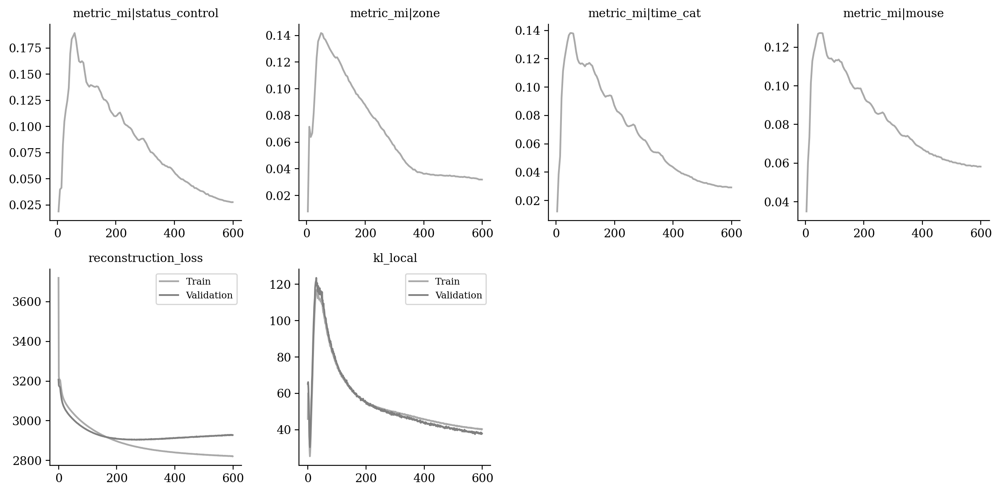

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

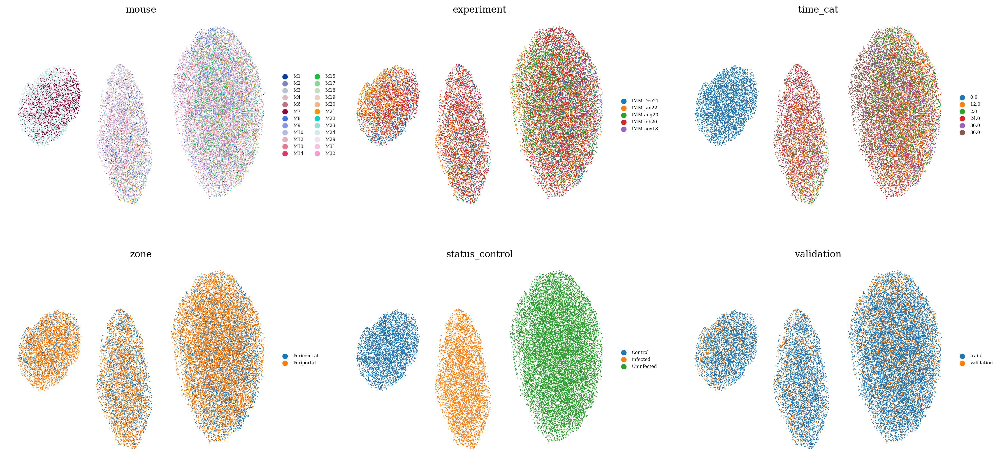

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

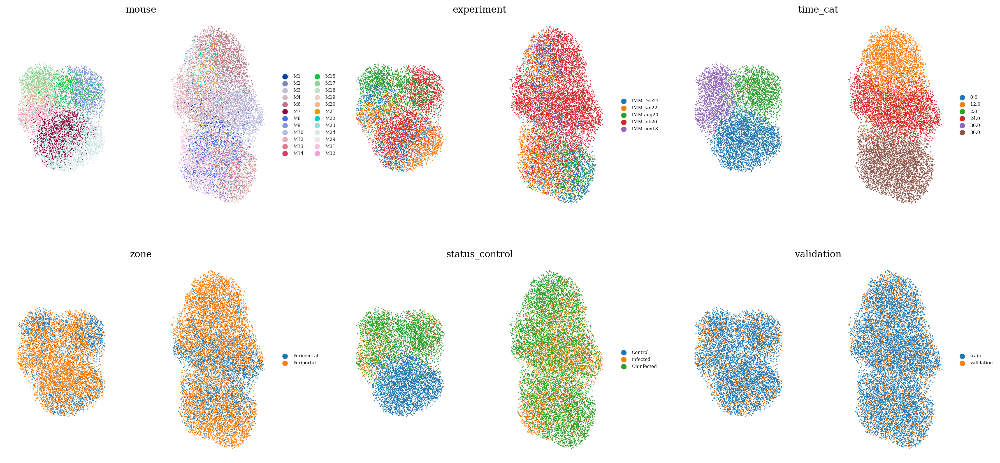

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

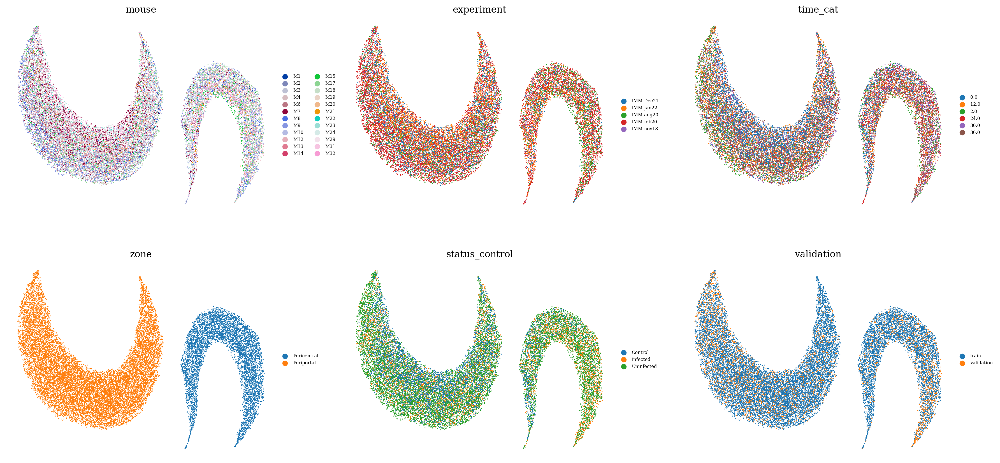

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

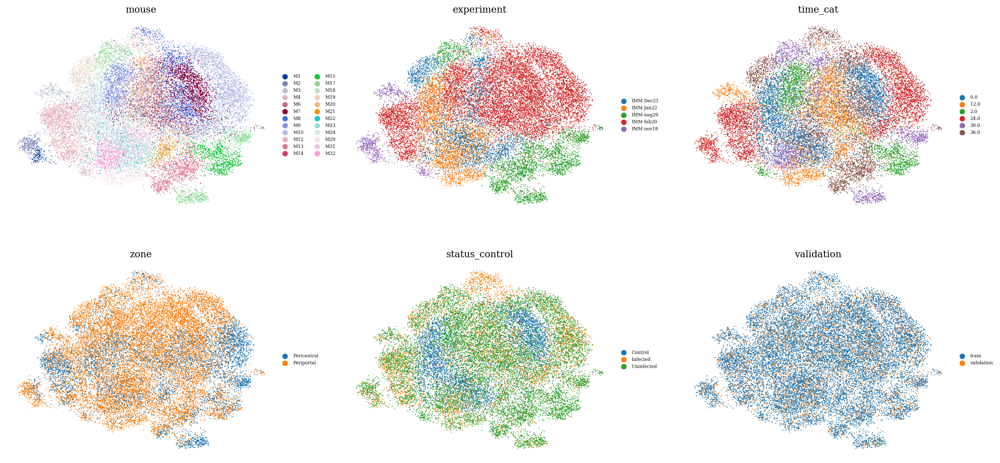

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

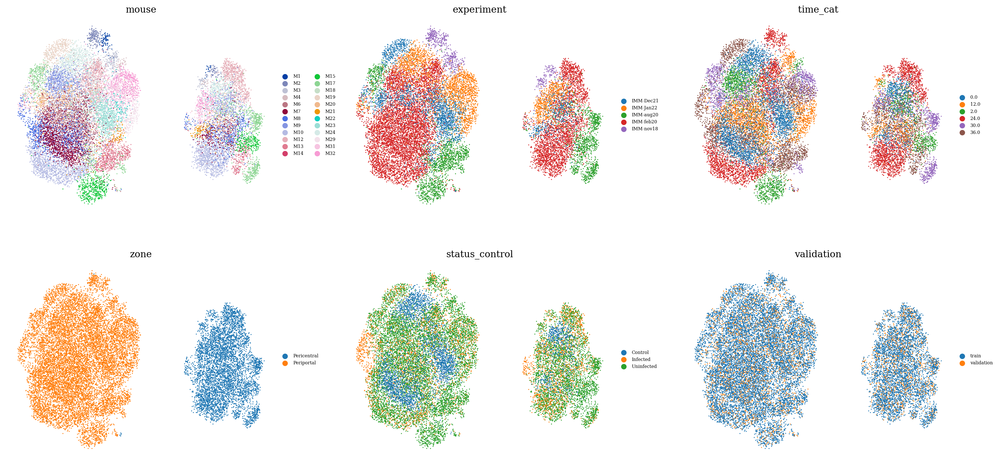

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

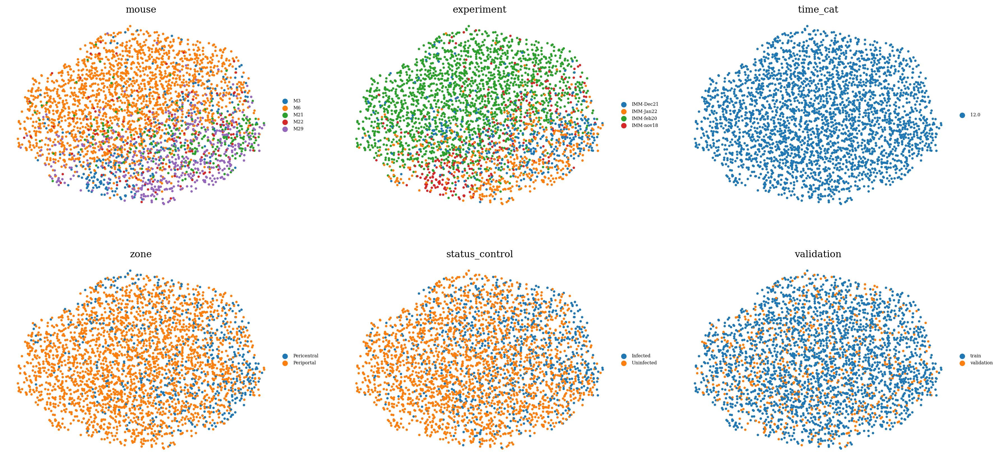

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )